# Libraries and Stuff

In [1]:
import os
import sys
import glob
import numpy as np
import scipy.optimize as op
import matplotlib.pyplot as plt
import urllib.request
from astropy.io import fits as pyfits
from astropy.table import Table
import pandas as pd

global local_dir
global z_bin
global qlor
global lbl

local_dir = "/home/holman/FILES/P1D/"
#ini  = { 0 , 1 , 2 , 3 , 4 , 5 , 6 , 7 , 8 , 9 ,10 ,11 ,12 }
#num = Number of redshift bins to be plotted
#ini = Starter plotting bin
z_bin = [2.2,2.4,2.6,2.8,3.0,3.2,3.4,3.6,3.8,4.0,4.2,4.4,4.6]
qlor = ["magenta","red","blue","black","lime","orange","cyan","mediumpurple","goldenrod","royalblue","silver","green","maroon"]
lbl = ["z = 2.2","z = 2.4","z = 2.6","z = 2.8","z = 3.0","z = 3.2","z = 3.4","z = 3.6","z = 3.8","z = 4.0","z = 4.2","z = 4.4","z = 4.6"]

# Not commonly used

In [2]:
def plotter_single(n,ini,fin,pha,mark,ms,ls):
    
    while (fin>13):
        fin = input('Below 13:')
        fin = int(fin)
        
    local_file = os.path.join(local_dir,n)
    PS=Table.read(local_file)


    plt.rcParams["figure.figsize"] = [18, 12]
    plt.rcParams["figure.autolayout"] = True
    plt.rcParams['font.size'] = '16'

    bines = fin - ini
    
    
    for a in range(bines):
        binZ = (PS['zbin'] == z_bin[ini+a])
        pl = PS[binZ]
        k = pl['meank']
        P = (pl['meanPk'] *  pl['meank'])/np.pi
        er = (pl['errorPk'] *  pl['meank'])/np.pi
        
        plt.errorbar(k , P , yerr = er, marker = mark, label = lbl[ini+a], 
                     markersize = ms, color = qlor[ini+a],alpha = pha, mec = 'k', linestyle = ls)
        
        
    plt.xlabel('$\overline{k}$ (km/s)$^{-1}$', size = 30)
    plt.ylabel(r' ${\Delta}^{2}$  =  $\overline{P(k)}*\frac{\overline{k}}{\pi{}}$', size = 30)
    plt.yscale('log')
    plt.grid(True, which="both", ls="--", color = 'gray', linewidth = 0.5)
    ax = plt.subplot(111)
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 1, box.height])
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.xticks([0.001, 0.002, 0.004, 0.006,0.008, 0.010, 0.012,0.014,0.016,0.018,0.020])
    plt.title(f'Transmitted Flux Power Spectrum {n}', size = 30)
    plt.show()

In [3]:
def plotter_compar(N,ini,fin):
    
    while (fin>13):
        fin = input('Must be major 13:')
        fin = int(fin)
        
    bines = fin - ini
    plt.rcParams["figure.figsize"] = [18, 12]
    plt.rcParams["figure.autolayout"] = True
    plt.rcParams['font.size'] = '16'
    
    loop1 = ['o','*','s','^','d']
    loop2 = ['-',':','--','-.','-']
    
    name = []
    
    for x in range(N):
        
        n = input(f'Name of file {x+1} on disk:')
        par_ask = input(f'Default parameters?(1/0)')
        par_ask = int(par_ask)
        
        name.append(n)
        
        if (par_ask == 1):
            mark = loop1[x]
            ms = 10
            pha = 0.7
            ls = loop2[x]
        else:
            print(f'For {x+1}:')
            mark = input('Marker:')
            ms = input('Markersize:')
            ms = int(ms)
            pha = input('Alpha:')
            pha = float(pha)
            ls = input('Linestyle:')
            
        local_file = os.path.join(local_dir,n)
        PS=Table.read(local_file)
        for a in range(bines):
            binZ = (PS['zbin'] == z_bin[ini+a])
            pl = PS[binZ]
            k = pl['meank']
            P = (pl['meanPk'] *  pl['meank'])/np.pi
            er = (pl['errorPk'] *  pl['meank'])/np.pi
            plt.errorbar(k , P , yerr = er, marker = mark, label = lbl[ini+a],
                         markersize = ms, color = qlor[ini+a],alpha = pha, mec = 'k', linestyle = ls)
        
    plt.xlabel('$\overline{k}$ (km/s)$^{-1}$', size = 30)
    plt.ylabel(r' ${\Delta}^{2}$  =  $\overline{P(k)}*\frac{\overline{k}}{\pi{}}$', size = 30)
    plt.yscale('log')
    plt.grid(True, which="both", ls="--", color = 'gray', linewidth = 0.5)
    ax = plt.subplot(111)
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 1, box.height])
    
    ax.legend(lbl[ini:fin]
              ,loc = 'lower right',bbox_to_anchor=(1, 0.025), ncol=5, fontsize = 20)
    plt.xticks([0.001, 0.002, 0.004, 0.006,0.008, 0.010, 0.012,0.014,0.016,0.018,0.020])
    
        
    
    
    props = dict(boxstyle='round', facecolor='white', alpha=0.7)
    
    
    textstr = '\n'.join('\n')
    
    for v in range(N):
        if (loop1[v] == 'o'):
            textstr = textstr + str(v+1)+ ". " + '['+ r'$\bullet$' +'] ' + str(name[v]) + '\n'
        if (loop1[v] == '*'):
            textstr = textstr + str(v+1)+ ". " + '['+ r'$\star$' +'] ' + str(name[v]) + '\n'
        if (loop1[v] == 's'):
            textstr = textstr + str(v+1)+ ". " + '['+ r'$\boxdot$' +'] ' + str(name[v]) + '\n'
        if (loop1[v] == '^'):
            textstr = textstr + str(v+1)+ ". " + '['+ r'$\blacktriangle$' +'] ' + str(name[v]) + '\n'
        if (loop1[v] == 'd'):
            textstr = textstr + str(v+1)+ ". " + '['+ r'$\diamond$' +'] ' + str(name[v]) + '\n'
            
        
    
    
    ax.text(0.05,0.95,textstr, transform=ax.transAxes, fontsize=20,verticalalignment='top', bbox= props)
    
    plt.title(f'Transmitted Flux Power Spectrum comparison', size = 30)
    plt.show()

In [4]:
def compar_singlebin2(n1,n2,ini):
    
    while (ini>13):
        ini = input('Must be minor than 13:')
        ini = int(ini)
        
    local_file1 = os.path.join(local_dir,n1)
    PS1=Table.read(local_file1)
    
    local_file2 = os.path.join(local_dir,n2)
    PS2=Table.read(local_file2)
        
    binZ1 = (PS1['zbin'] == z_bin[ini])
    pl1 = PS1[binZ1]
    k1 = pl1['meank']
    P1 = (pl1['meanPk'] *  pl1['meank'])/np.pi
    er1 = (pl1['errorPk'] *  pl1['meank'])/np.pi
    fu_1 = ((er1)) + (P1)
    fl_1 = (P1) - ((er1))
    
    binZ2 = (PS2['zbin'] == z_bin[ini])
    pl2 = PS2[binZ2]
    k2 = pl2['meank']
    P2 = (pl2['meanPk'] *  pl2['meank'])/np.pi
    er2 = (pl2['errorPk'] *  pl2['meank'])/np.pi
    fu_2 = ((er2)) + (P2)
    fl_2 = (P2) - ((er2))
    
    EP = abs((pl2['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
    
    fig, axs = plt.subplots(2,1,figsize=(18,12), gridspec_kw={'height_ratios': [2, 0.5]})
    
    axs[0].errorbar(k1,P1,yerr = er1, marker = 's', label = "bin z = "+str(z_bin[ini])+"  "+str(n1), markersize = 7,\
        color = qlor[ini], alpha = 0.6, mec ='k', linestyle = "--")
    axs[0].fill_between(k1,fu_1,fl_1, alpha = 0.1,label = 'Error coverage ' + str(n1))
    
    axs[0].errorbar(k2,P2,yerr = er2, marker = 'o', label = "bin z = "+str(z_bin[ini])+"  "+str(n2), markersize = 8, \
        color = qlor[ini], alpha = 0.7, mec ='k', linestyle = "-")
    axs[0].fill_between(k2,fu_2,fl_2, alpha = 0.1,label = 'Error coverage '+ str(n2))
    
    
    axs[0].set_ylabel('${\Delta}^{2}$ [$\overline{Pk}$]', size = 30)
    axs[0].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
    axs[0].legend(loc='upper left')
    axs[0].set_xticks([0.001, 0.002, 0.004, 0.006,0.008, 0.010, 0.012,0.014,0.016,0.018,0.020])
    
    axs[1].plot(k1,EP, marker = 'o', markersize = 8,color = qlor[ini], alpha = 0.7, mec ='k')
    axs[1].set_xlabel('$\overline{k}$ (km/s)$^{-1}$', size = 30)
    axs[1].set_ylabel('% diff', size = 30)
    axs[1].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)

In [6]:
def p1d_HQl(n,ini,fin,pha,mark,ms,ls,survey,DPI,w,h,AlS,LS,TS,Nc):
    
    while (fin>13):
        fin = input('Below 13:')
        fin = int(fin)
        
    local_file = os.path.join(local_dir,n)
    p1d_file = pyfits.open(local_file)
    PS = Table.read(p1d_file[1])
    chunks = Table.read(p1d_file[2])


    plt.rcParams['axes.spines.left'] = True
    plt.rcParams['axes.spines.right'] = True
    plt.rcParams['axes.spines.top'] = True
    plt.rcParams['axes.spines.bottom'] = True
    plt.rcParams["figure.figsize"] = [19, 10]
    plt.rcParams["figure.autolayout"] = True

    plt.figure(figsize=(w,h),dpi=int(DPI))

    bines = fin - ini
    
    N_forest = []
    
    for a in range(bines):
        binZ = (PS['zbin'] == z_bin[ini+a])
        pl = PS[binZ]
        k = pl['meank']
        P = (pl['meanPk'] *  pl['meank'])/np.pi
        er = (pl['errorPk'] *  pl['meank'])/np.pi
        plt.errorbar(k , P , yerr = er, marker = mark,  
                     label = lbl[ini+a]+' ('+str(int(chunks['N_chunks'][a]))+ ' forests)',
                     markersize = ms, color = qlor[ini+a],alpha = pha, mec = 'k', linestyle = ls)
        N_forest.append(chunks['N_chunks'][a])
        
    plt.ylabel(r' ${\Delta}^{2}$  =  $\overline{P(k)}*\frac{\overline{k}}{\pi{}}$',style = 'oblique', family = 'serif', size = AlS)
    plt.xlabel('$\overline{k}$ $(\AA^{-1})$',style = 'oblique', family = 'serif', size = AlS)
    plt.yscale('log')
    plt.grid(True, which="both", ls=":", color = 'gray', linewidth = 0.8)
    ax = plt.subplot(111)
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 1, box.height])
    ax.legend(loc = 'lower right',bbox_to_anchor=(1, 0.025), ncol=Nc, fontsize = LS)
    plt.xticks([0.0,0.25,0.50,0.75,1.0,1.25,1.50,1.75,2.0],fontsize = 15)
    plt.yticks(fontsize = 15)
    plt.title(f'Transmitted Flux Power Spectrum {str(survey)} sample', weight='semibold', 
                style= 'normal', family = 'serif', size =TS)
    plt.show()
    
    U = 0
    for b in range(len(N_forest)):
        U = N_forest[b] + U
        
    print(f'Number of forest {int(U)}')

In [30]:
def p1d_HQv(n,ini,fin,pha,mark,ms,ls,survey,DPI,w,h,AlS,LS,TS,Nc):
    
    while (fin>13):
        fin = input('Below 13:')
        fin = int(fin)
    
    local_file = os.path.join(local_dir,n)
    p1d_file = pyfits.open(local_file)
    PS = Table.read(p1d_file[1])
    chunks = Table.read(p1d_file[2])

    plt.rcParams['axes.spines.left'] = True
    plt.rcParams['axes.spines.right'] = True
    plt.rcParams['axes.spines.top'] = True
    plt.rcParams['axes.spines.bottom'] = True
    plt.rcParams["figure.figsize"] = [19, 10]
    plt.rcParams["figure.autolayout"] = True

    plt.figure(figsize=(w,h),dpi=int(DPI))

    bines = fin - ini
    
    PROJECT = np.char.find(n, "DESI", start=0, end=None)
    
    N_forest = []
    
    if (PROJECT<0):
        
        for a in range(bines):
            binZ = (PS['zbin'] == z_bin[ini+a])
            pl = PS[binZ]
            k = pl['meank']
            P = (pl['meanPk'] *  pl['meank'])/np.pi
            er = (pl['errorPk'] *  pl['meank'])/np.pi
        
            plt.errorbar(k , P , yerr = er, marker = mark, 
                         label = lbl[ini+a]+' ('+str(int(chunks['N_chunks'][a]))+ ' forests)',
                         markersize = ms, color = qlor[ini+a],alpha = pha, mec = 'k', linestyle = ls)
            N_forest.append(chunks['N_chunks'][a])
        
        
        plt.ylabel(r' ${\Delta}^{2}$  =  $\overline{P(k)}*\frac{\overline{k}}{\pi{}}$',style = 'oblique',
                   family = 'serif', size = AlS)          
        plt.xlabel('$\overline{k}$ (km/s)$^{-1}$',style = 'oblique', family = 'serif', size = AlS)
        plt.yscale('log')
        plt.grid(True, which="both", ls=":", color = 'gray', linewidth = 0.8)
        ax = plt.subplot(111)
        box = ax.get_position()
        ax.set_position([box.x0, box.y0, box.width * 1, box.height])
        ax.legend(loc = 'lower right',bbox_to_anchor=(1, 0.010), ncol=Nc, fontsize = LS)
        plt.xticks([0.001, 0.002, 0.004, 0.006,0.008, 0.010, 0.012,0.014,0.016,0.018,0.020],fontsize = 15)
        plt.yticks(fontsize = 15)
        #plt.title(fr'Transmitted Flux Power Spectrum (${P}_{F1D}$) {str(survey)} quasar sample', weight='semibold',
                  #style= 'normal', family = 'serif', size =TS)
        plt.savefig('p1d_DR14-old.png', bbox_inches='tight') 
        plt.show()
        
    else:
        
        cut = np.array([45,48,51,54,57,60,63,66,69,72,75,78,81,84])
        
        for a in range(bines):
            binZ = (PS['zbin'] == z_bin[ini+a])
            pl = PS[binZ]
            k = pl['meank']
            P = (pl['meanPk'] *  pl['meank'])/np.pi
            er = (pl['errorPk'] *  pl['meank'])/np.pi
            k = k[0:cut[a]+1]
            P = P[0:cut[a]+1]
            er = er[0:cut[a]+1]
            
            plt.errorbar(k , P , yerr = er, marker = mark, 
                         label = lbl[ini+a]+' ('+str(int(chunks['N_chunks'][a]))+ ' forests)',
                         markersize = ms, color = qlor[ini+a],alpha = pha, mec = 'k', linestyle = ls)
            N_forest.append(chunks['N_chunks'][a])            
        
        
        plt.ylabel(r' ${\Delta}^{2}$  =  $\overline{P(k)}*\frac{\overline{k}}{\pi{}}$',style = 'oblique',
                   family = 'serif', size = AlS)          
        plt.xlabel('$\overline{k}$ (km/s)$^{-1}$',style = 'oblique', family = 'serif', size = AlS)
        plt.yscale('log')
        plt.grid(True, which="both", ls=":", color = 'gray', linewidth = 0.8)
        ax = plt.subplot(111)
        box = ax.get_position()
        ax.set_position([box.x0, box.y0, box.width * 1, box.height])
        ax.legend(loc = 'lower right',bbox_to_anchor=(1, 0.010), ncol=Nc, fontsize = LS)
        plt.xticks([0.000, 0.005, 0.010, 0.015,0.020, 0.025, 0.030,0.035,0.040],fontsize = 15)
        plt.yticks(fontsize = 15)
        plt.title(r'Transmitted Flux Power Spectrum (${P}_{F1D}$) {str(survey)} quasar sample', weight='semibold',
                  style= 'normal', family = 'serif', size =TS)
        plt.savefig('p1d_DR14-old.png', bbox_inches='tight') 
        plt.show()
    
    U = 0
    for b in range(len(N_forest)):
        U = N_forest[b] + U
        
    print(f'Number of forest {int(U)}')

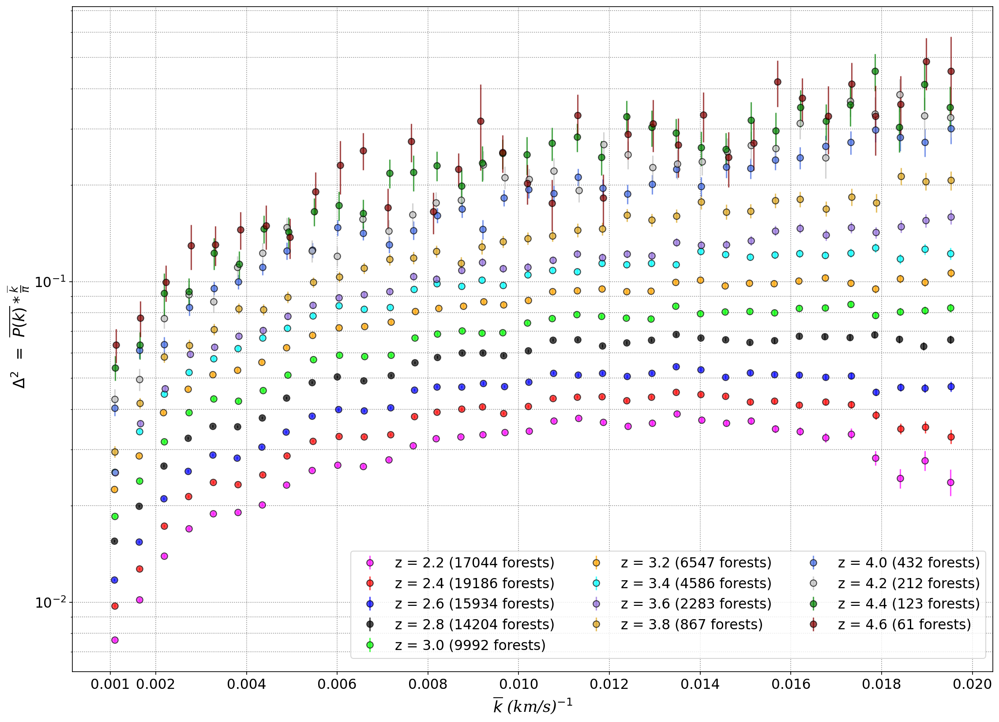

Number of forest 91471


In [35]:
p1d_HQv('P1D_eBOSS_DR14_Standard-v4.fits.gz',0,13,0.7,'o',7,'','eBOSS',150,15.2,11,17,15,15,3)

# Error comparisons

In [2]:
def error_compar2(n1,n2,ini,fin,Hr1,Hr2,Wf,Hf,title1,title2,eFB=8,name='Def'):

    while (ini>13):
        ini = input('Must be minor than 13:')
        ini = int(ini)
         
    local_file1 = os.path.join(local_dir,n1)
    p1d_file1 = pyfits.open(local_file1)
    PS1 = Table.read(p1d_file1[1])
    chunks1 = Table.read(p1d_file1[2])
    
    local_file2 = os.path.join(local_dir,n2)
    p1d_file2 = pyfits.open(local_file2)
    PS2 = Table.read(p1d_file2[1])
    chunks2 = Table.read(p1d_file2[2])
    
    
    bines = fin - ini
    
    
    fig, axs = plt.subplots(2,1,figsize=(Wf,Hf), gridspec_kw={'height_ratios': [Hr1, Hr2]}, dpi = 150)
        
    for a in range(bines):
        binZ1 = (PS1['zbin'] == z_bin[ini+a])
        pl1 = PS1[binZ1]
        k1 = pl1['meank']
        P1 = (pl1['meanPk'] *  pl1['meank'])/np.pi # Error boundary 1
        er1 = (pl1['errorPk'] *  pl1['meank'])/np.pi # Error boundary 2
        fu_1 = ((er1)) + (P1)
        fl_1 = (P1) - ((er1))
        axs[0].errorbar(k1,P1,yerr = er1, marker = '*', 
                        label = lbl[ini+a]+' ('+str(int(chunks1['N_chunks'][a]))+ ' forests)',
                        markersize = 7,color = qlor[ini+a], alpha = 0.7, mec ='k', linestyle = "--") 
        axs[0].fill_between(k1,fu_1,fl_1, alpha = 0.1)
        
    for a in range(bines):
        binZ2 = (PS2['zbin'] == z_bin[ini+a])
        pl2 = PS2[binZ2]
        k2 = pl2['meank']
        P2 = (pl2['meanPk'] *  pl2['meank'])/np.pi # Error boundary 1
        er2 = (pl2['errorPk'] *  pl2['meank'])/np.pi # Error boundary 2
        fu_2 = ((er2)) + (P2)
        fl_2 = (P2) - ((er2))
        EP = abs((pl2['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
        
        axs[0].errorbar(k2,P2,yerr = er2, marker = 'o', 
                        label = lbl[ini+a]+' ('+str(int(chunks2['N_chunks'][a]))+ ' forests)',
                        markersize = 8, color = qlor[ini+a], alpha = 0.6, mec ='k', linestyle = "-")
        axs[0].fill_between(k2,fu_2,fl_2, alpha = 0.1)
    
    
    AVE_ERROR = []
        
    for a in range(bines):
        binZ1 = (PS1['zbin'] == z_bin[ini+a])
        pl1 = PS1[binZ1]
        
        binZ2 = (PS2['zbin'] == z_bin[ini+a])
        pl2 = PS2[binZ2]
        EP = abs((pl2['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
        ave_flab = np.mean(np.array(EP))
        axs[1].plot(k2,EP, marker = '.', markersize = 8,
                    color = qlor[ini+a], alpha = 0.7,
                    label = r'$\mu\sim$'+str(round(ave_flab,1)),mec ='k')
        AVE_ERROR.append(ave_flab)
        if (a <= eFB):
            BE = abs(pl1['errorPk']/pl1['meanPk'])*100 # Base error from the control group
            eb1 = BE + abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 1
            eb2 = BE - abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 2
            axs[1].fill_between(k2,eb1,eb2, alpha = 0.1, color = qlor[ini+a])
                    
    AVE_ERROR = np.array(AVE_ERROR)
    
    
    #axs[0].set_title(f'{TITLE}', weight='semibold', 
                #style= 'normal', family = 'serif', size =30)
    
    axs[0].set_ylabel('${\Delta}^{2}$ (P($\overline{k}))$', size = 30)
    axs[0].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
    axs[0].set_xticks([0.001, 0.002, 0.004, 0.006,0.008, 0.010, 0.012,0.014,0.016,0.018,0.020])
    axs[0].set_yscale('log')
    
    
    txt_prop = {'size' :12}
    txt_propT = {'style' : 'normal', 'family' : 'serif', 'size' :20, 'weight':'semibold'}
    
    S = r'[$\star$]'
    B = r'[$\bullet$]'
    
    
    axs[0].legend(loc = 'lower right', ncol= 4, prop = txt_prop,
                  title_fontproperties=txt_propT,
                  title=f'{S} {title1} | {B} {title2}')

    
    
    

    axs[1].set_xlabel('$\overline{k}$ (km/s)$^{-1}$', size = 30)
    axs[1].set_ylabel(r'$\frac{|P(\overline{k})[\bullet]-P(\overline{k})[\star]|}{P(\overline{k})[\star]}$%', size = 30)
    #axs[1].set_ylim(0, 50)
    axs[1].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
    axs[1].legend(loc = 'upper center', ncol=7, fontsize = 12)
    plt.title(f'Percentage difference ratio', size = 30)
    print(f'Average difference {round(np.mean(AVE_ERROR),2)}%')
    plt.savefig(name, bbox_inches='tight')
    plt.show()

Average difference 6.19%


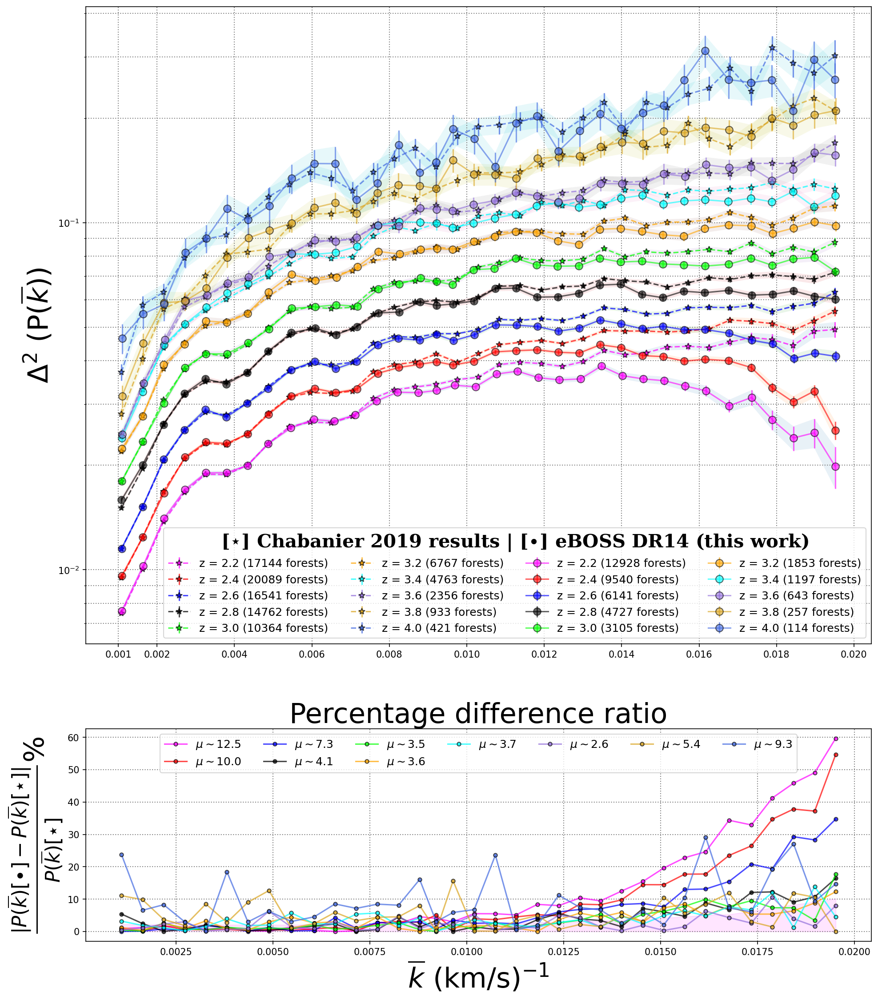

In [5]:
error_compar2('P1D_eBOSS_Chabanier2019_results.fits','P1D_eBOSS_DR14_Standard-master.fits.gz',
              0,10,3,1,15.2,18.2,
              'Chabanier 2019 results','eBOSS DR14 (this work)',0,'Chabanier compar.png')

Average difference 4.45%


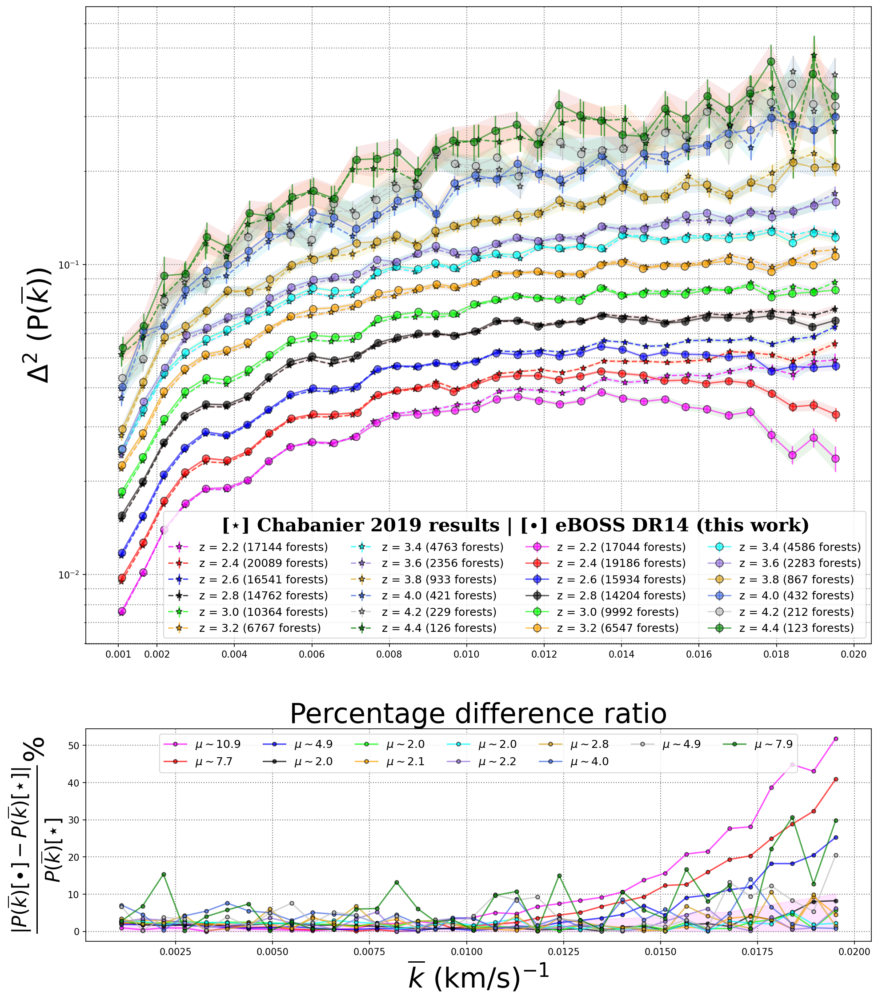

In [3]:
error_compar2('P1D_eBOSS_Chabanier2019_results.fits','P1D_eBOSS_DR14_Standard-v4.fits.gz',
              0,12,3,1,15.2,18.2,
              'Chabanier 2019 results','eBOSS DR14 (this work)',0,'Chabanier compar.png')

Average difference 4.13%


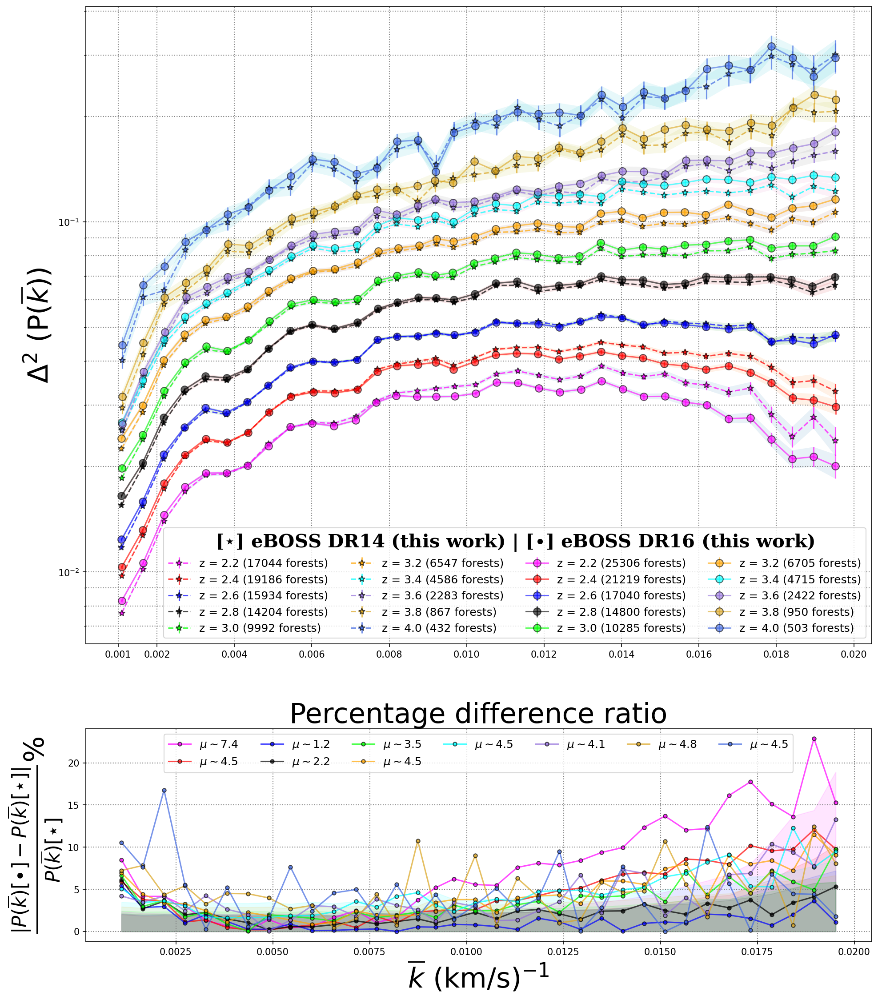

In [231]:
#P1D_eBOSS_Chabanier2019_results.fits
#P1D_eBOSS_DR14_Standard-v4.fits.gz
#P1D_eBOSS_DR14_NcorF.fits.gz

error_compar2('P1D_eBOSS_DR14_Standard-v4.fits.gz','P1D_eBOSS_DR16_Standard-v4.fits.gz',
              0,10,3,1,15.2,18.2,
              'eBOSS DR14 (this work)','eBOSS DR16 (this work)',6,'eBOSS compar.png')

In [227]:
def error_compar2_lambda(n1,n2,ini,fin,Hr1,Hr2,Wf,Hf,title1,title2,eFB=8,name='Def'):

    while (ini>13):
        ini = input('Must be minor than 13:')
        ini = int(ini)
         
    local_file1 = os.path.join(local_dir,n1)
    p1d_file1 = pyfits.open(local_file1)
    PS1 = Table.read(p1d_file1[1])
    chunks1 = Table.read(p1d_file1[2])
    
    local_file2 = os.path.join(local_dir,n2)
    p1d_file2 = pyfits.open(local_file2)
    PS2 = Table.read(p1d_file2[1])
    chunks2 = Table.read(p1d_file2[2])
    
    
    bines = fin - ini
    
    
    fig, axs = plt.subplots(2,1,figsize=(Wf,Hf), gridspec_kw={'height_ratios': [Hr1, Hr2]}, dpi = 150)
        
    for a in range(bines):
        binZ1 = (PS1['zbin'] == z_bin[ini+a])  & (PS1['meank'] <= 2.02)
        pl1 = PS1[binZ1]
        k1 = pl1['meank']
        P1 = (pl1['meanPk'] *  pl1['meank'])/np.pi
        er1 = (pl1['errorPk'] *  pl1['meank'])/np.pi
        fu_1 = ((er1)) + (P1)
        fl_1 = (P1) - ((er1))
        axs[0].errorbar(k1,P1,yerr = er1, marker = '*', 
                        label = lbl[ini+a]+' ('+str(int(chunks1['N_chunks'][a+ini]))+ ' forests)',
                        markersize = 6,color = qlor[ini+a], alpha = 0.7, mec ='k', linestyle = "--") 
        axs[0].fill_between(k1,fu_1,fl_1, alpha = 0.1)
        
    for a in range(bines):
        binZ2 = (PS2['zbin'] == z_bin[ini+a]) & (PS2['meank'] <= 2.02)
        pl2 = PS2[binZ2]
        k2 = pl2['meank']
        P2 = (pl2['meanPk'] *  pl2['meank'])/np.pi
        er2 = (pl2['errorPk'] *  pl2['meank'])/np.pi
        fu_2 = ((er2)) + (P2)
        fl_2 = (P2) - ((er2))
        EP = abs((pl2['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
        
        axs[0].errorbar(k2,P2,yerr = er2, marker = 'o', 
                        label = lbl[ini+a]+' ('+str(int(chunks2['N_chunks'][a+ini]))+ ' forests)',
                        markersize = 6, color = qlor[ini+a], alpha = 0.6, mec ='k', linestyle = "-")
        axs[0].fill_between(k2,fu_2,fl_2, alpha = 0.1)
    
    
    AVE_ERROR = []
        
    for a in range(bines):
        binZ1 = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= 2.02)
        pl1 = PS1[binZ1]
        
        binZ2 = (PS2['zbin'] == z_bin[ini+a]) & (PS2['meank'] <= 2.02)
        pl2 = PS2[binZ2]
        EP = abs((pl2['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
        ave_flab = np.mean(np.array(EP))
        axs[1].plot(k2,EP, marker = '.', markersize = 8,
                    color = qlor[ini+a], alpha = 0.7,
                    label = r'$\mu\sim$'+str(round(ave_flab,1)),mec ='k')
        AVE_ERROR.append(ave_flab)
        if (a <= eFB):
            BE = abs(pl1['errorPk']/pl1['meanPk'])*100 # Base error from the control group
            eb1 = BE + abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 1
            eb2 = BE - abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 2
            axs[1].fill_between(k2,eb1,eb1, alpha = 0.1,color = qlor[ini+a])
        
    AVE_ERROR = np.array(AVE_ERROR)
    
    
    #axs[0].set_title(f'{TITLE}', weight='semibold', 
                #style= 'normal', family = 'serif', size =30)
    
    axs[0].set_ylabel('${\Delta}^{2}$ (P($\overline{k}))$', size = 30)
    axs[0].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
    axs[0].set_xticks([0.0,0.25,0.50,0.75,1.0,1.25,1.50,1.75,2.0])
    axs[0].set_yscale('log')
    
    
    txt_prop = {'size' :13}
    txt_propT = {'style' : 'normal', 'family' : 'serif', 'size' :17, 'weight':'semibold'}
    
    S = r'[$\star$]'
    B = r'[$\bullet$]'
    
    
    axs[0].legend(loc = 'lower right', ncol= 2, prop = txt_prop,
                  title_fontproperties=txt_propT,
                  title=f'{S} {title1} | {B} {title2}')

    
    
    

    axs[1].set_xlabel('$\overline{k}$ $(\AA^{-1})$', size = 30)
    axs[1].set_ylabel(r'$\frac{|P(\overline{k})[\bullet]-P(\overline{k})[\star]|}{P(\overline{k})[\star]}$%', size = 30)
    axs[1].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
    axs[1].legend(loc = 'upper center', ncol=7, fontsize = 15)
    plt.title(f'Percentage difference ratio', size = 30)
    print(f'Prepared for mean file from Corentin...')
    print(f'Average difference {round(np.mean(AVE_ERROR),2)}%')
    plt.savefig(name, bbox_inches='tight')
    plt.show()

Prepared for mean file from Corentin...
Average difference 4.69%


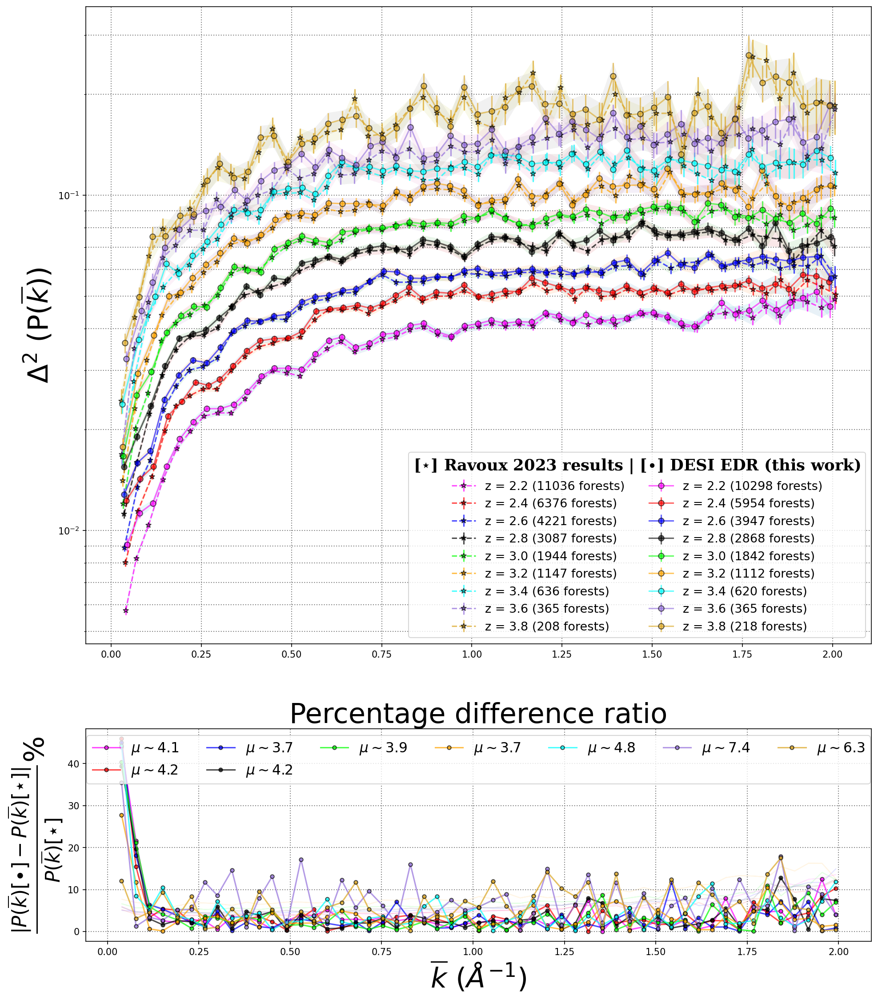

In [233]:
#P1D_DESI_SV1-3_Standard_lambunits.fits.gz
#mean_Pk1d_fit_snr_medians.fits.gz
#P1D_DESI_SV13CorentinDelts2_godbinng.fits.gz
error_compar2_lambda('mean_Pk1d_fit_snr_medians.fits.gz','P1D_DESI_SC.fits.gz',
              0,9,3,1,15.2,18.2,
              'Ravoux 2023 results','DESI EDR (this work)',5,'DESI compar.png')

# Systematics

In [182]:
def systematics(n1,n2,ini,fin,Hr1,Hr2,Wf,Hf,title,eFB=8,name='Def'):

    while (ini>13):
        ini = input('Must be minor than 13:')
        ini = int(ini)
        
    local_file1 = os.path.join(local_dir,n1)
    PS1=Table.read(local_file1)
    
    print(n1)
    bines = fin - ini
    
    fig, axs = plt.subplots(len(n2),1,figsize=(Wf,Hf),gridspec_kw={'hspace':0.3}, dpi = 150)#, gridspec_kw={'height_ratios': [Hr1, Hr2]}
    
    marks = ['o','*','s']
    
    boundary = 0
    
    if (((np.char.find(title, "DESI", start=0, end=None))>=0)):
        boundary = 2.05
    else:
        boundary = 0.02
  
    for h in range(len(n2)):

        print(n2[h])
        local_file2 = os.path.join(local_dir,n2[h])
        PS2=Table.read(local_file2)
        
        if ((np.char.find(n2[h], "DLA", start=0, end=None))>=0):
            budget_name = "Skipping DLA corrections"
        elif ((np.char.find(n2[h], "BAL", start=0, end=None))>=0):
            budget_name = "Including BAL quasars in the computation"
        elif ((np.char.find(n2[h], "Sky", start=0, end=None))>=0):
            budget_name = "Skipping skylines masking"
        
        
        for a in range(bines):
            binZ1 = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= boundary)
            pl1 = PS1[binZ1]
            k1 = pl1['meank']
            P1 = (pl1['meanPk'] *  pl1['meank'])/np.pi
            er1 = (pl1['errorPk'] *  pl1['meank'])/np.pi
            fu_1 = ((er1)) + (P1)
            fl_1 = (P1) - ((er1))
            
            binZ2 = (PS2['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= boundary)
            pl2 = PS2[binZ2]
            k2 = pl2['meank']
            P2 = (pl2['meanPk'] *  pl2['meank'])/np.pi
            er2 = (pl2['errorPk'] *  pl2['meank'])/np.pi
            fu_2 = ((er2)) + (P2)
            fl_2 = (P2) - ((er2))
            EP = abs((pl2['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
            if (a <= eFB):
                BE = abs(pl1['errorPk']/pl1['meanPk'])*100 # Base error from the control group
                eb1 = BE + abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 1
                eb2 = BE - abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 2
                axs[h].fill_between(k2,eb1,eb2, alpha = 0.1, label = None)
            
            axs[h].plot(k2,EP, marker = marks[h], markersize = 8,color = qlor[ini+a], 
                        alpha = 0.7, mec ='k',label = lbl[ini+a])

                
            

        
            
        
        axs[h].set_ylabel(r'$\frac{|P(\overline{k})-{P}_{control}(\overline{k})|}{{P}_{control}(\overline{k})}$%', size = 30)
        axs[h].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
        axs[h].set_title(f'{budget_name}', size = 20)
        txt_prop = {'style' : 'italic'}
        axs[h].legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=1, prop = txt_prop) #lbl[ini:fin]


        
        if (((np.char.find(title, "DESI", start=0, end=None))>=0)):
            axs[h].set_xticks([0.0,0.25,0.50,0.75,1.0,1.25,1.50,1.75,2.0])
            axs[h].set_xlim([0.0,2.0])
        else:
            axs[h].set_xticks([0.001, 0.002, 0.004, 0.006,0.008, 0.010, 0.012,0.014,0.016,0.018,0.020])
            axs[h].set_xlim([0.0,0.02])
         
        if ((h==2) and ((np.char.find(title, "BOSS", start=0, end=None))>=0)):
            axs[h].set_xlabel('$\overline{k}$ (km/s)$^{-1}$', size = 30)
            plt.savefig(name, bbox_inches='tight')
            print('eBOSS MODE')
            
        if ((h==1) and ((np.char.find(title, "DESI", start=0, end=None))>=0)):
            axs[h].set_xlabel('$\overline{k}$ $(\AA^{-1})$', size = 30)
            plt.savefig(name, bbox_inches='tight')
            print('DESI MODE')


P1D_DESI_Standard.fits.gz
P1D_DESI_BALsincu.fits.gz
P1D_DESI_Skynocor.fits.gz
DESI MODE


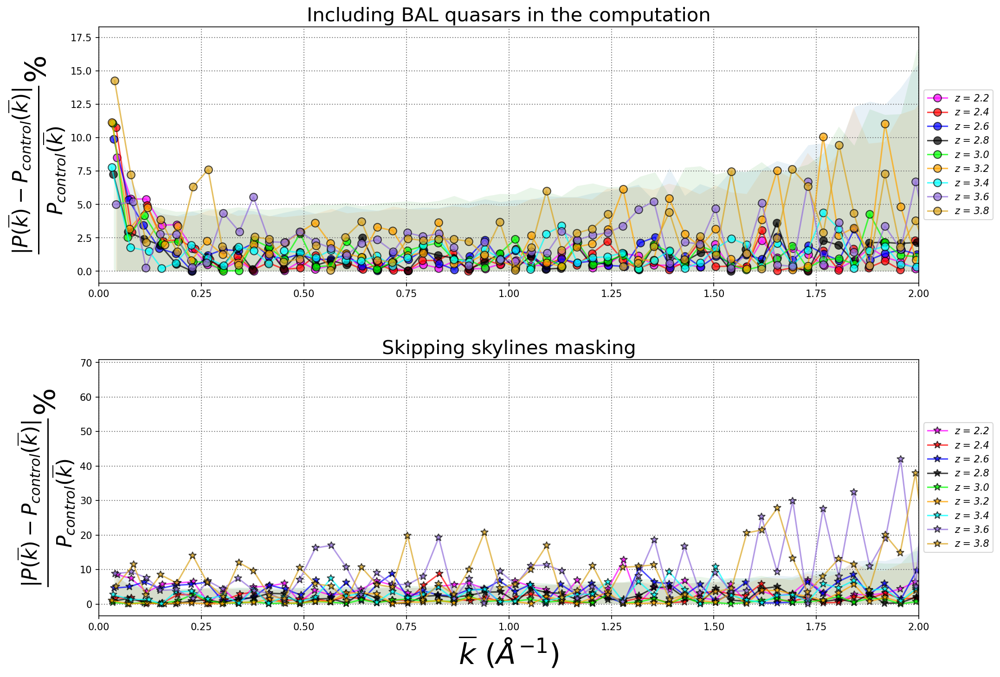

In [186]:
systematics('P1D_DESI_Standard.fits.gz',
                  ['P1D_DESI_BALsincu.fits.gz','P1D_DESI_Skynocor.fits.gz'],
                  0,9,3,1,15.2,11,'DESI EDR',2,'Sistems DESI EDR.png')

P1D_eBOSS_DR14_Standard-master.fits.gz
P1D_eBOSS_DR14_DLAnot_corrected.fits.gz
P1D_eBOSS_DR14_BALincluded.fits.gz
P1D_eBOSS_DR14_SkyLines_included.fits.gz
eBOSS MODE


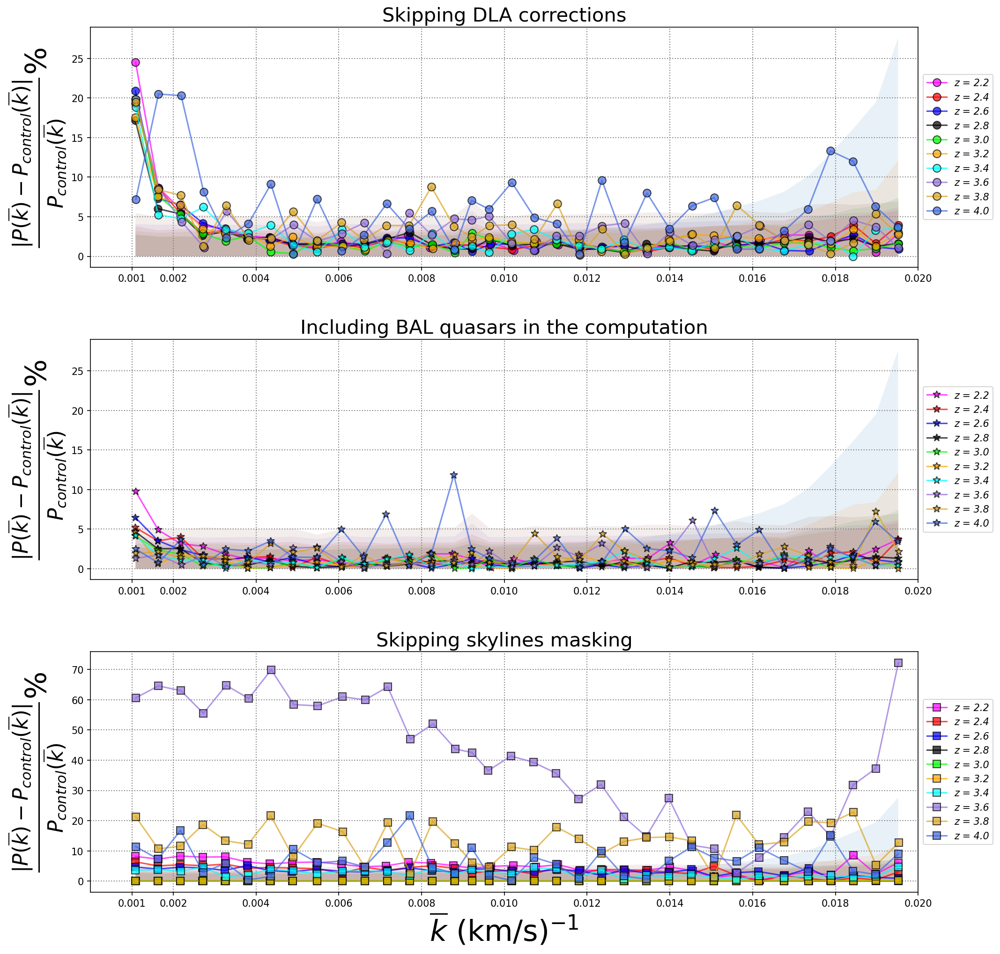

In [188]:
systematics('P1D_eBOSS_DR14_Standard-master.fits.gz',
                  ['P1D_eBOSS_DR14_DLAnot_corrected.fits.gz','P1D_eBOSS_DR14_BALincluded.fits.gz',
                   'P1D_eBOSS_DR14_SkyLines_included.fits.gz'],
                  0,10,3,1,15.2,16,'eBOSS DR14',5,'Sistems DR14.png')

P1D_eBOSS_DR16_Standard-master.fits.gz
P1D_eBOSS_DR16_DLAnot_corrected.fits.gz
P1D_eBOSS_DR16_BALincluded.fits.gz
P1D_eBOSS_DR16_SkyLines_included.fits.gz
eBOSS MODE


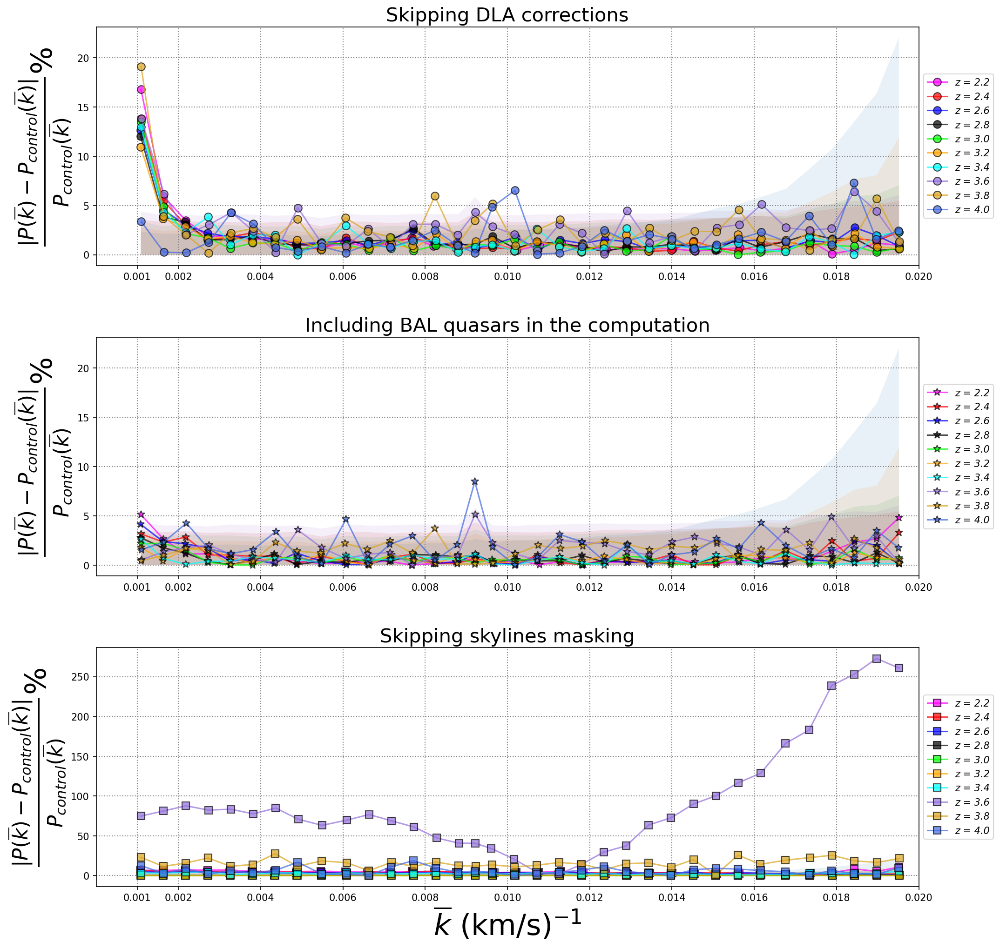

In [191]:
systematics('P1D_eBOSS_DR16_Standard-master.fits.gz',
                  ['P1D_eBOSS_DR16_DLAnot_corrected.fits.gz','P1D_eBOSS_DR16_BALincluded.fits.gz',
                   'P1D_eBOSS_DR16_SkyLines_included.fits.gz'],
                  0,10,3,1,15.2,16,'eBOSS DR16',4,'Sistems DR16.png')

# DESI comparisons (vel from picca)

Prepared for mean file from Corentin...
Average difference 9.77%
Average difference Pt1 13.82%
Average difference Pt2 5.49%


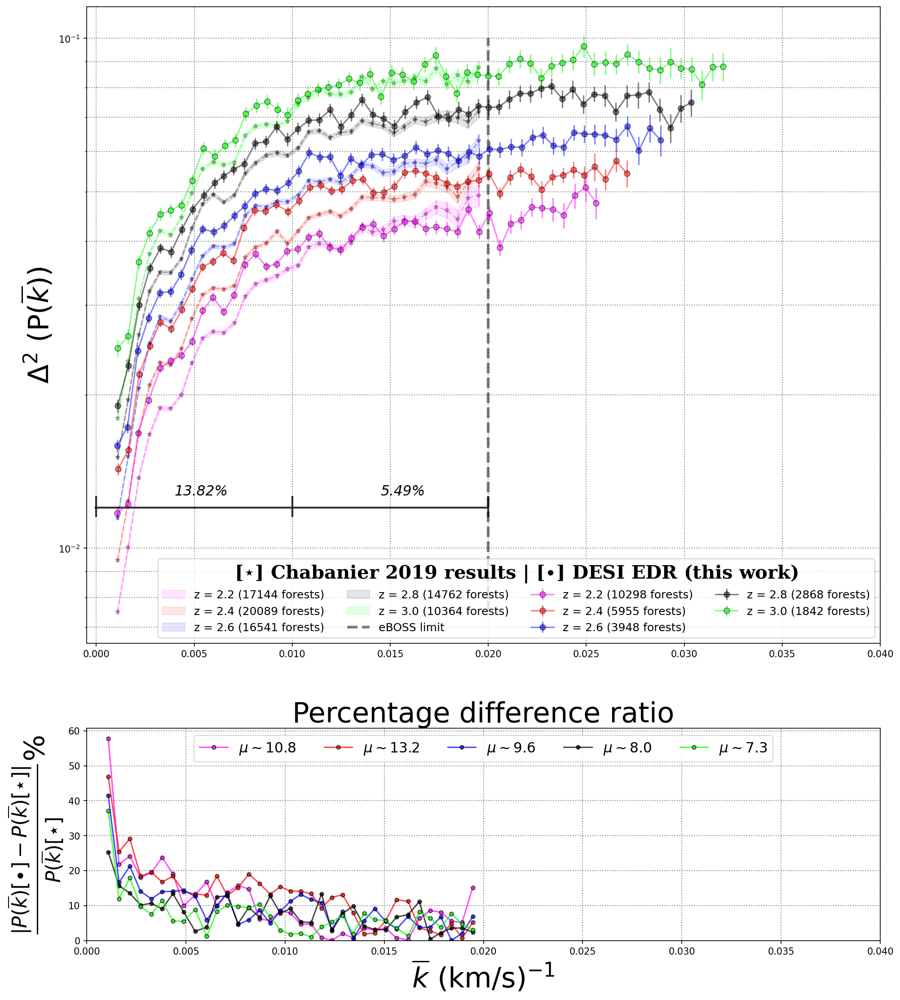

In [305]:
n1, n2 = ['P1D_eBOSS_Chabanier2019_results.fits','P1D_DESI_SC_vel_extent.fits.gz']
#n1, n2 = ['P1D_eBOSS_DR14_Standard-master.fits.gz','P1D_DESI_SC_vel_extent.fits.gz']


local_file1 = os.path.join(local_dir,n1)
p1d_file1 = pyfits.open(local_file1)
PS1 = Table.read(p1d_file1[1])
chunks1 = Table.read(p1d_file1[2])
    
local_file2 = os.path.join(local_dir,n2)
p1d_file2 = pyfits.open(local_file2)
PS2 = Table.read(p1d_file2[1])
chunks2 = Table.read(p1d_file2[2])
bines = 5 - 0
ini = 0
    
fig, axs = plt.subplots(2,1,figsize=(15.2,18), gridspec_kw={'height_ratios': [3,1]}, dpi = 150)
    
for a in range(bines+1):
    if (a==bines):
        axs[0].errorbar(k1,P1,yerr = er1, marker = 'none',
                     label = '',
                     markersize = 0,color = 'none', alpha = 0.0, mec ='none', linestyle = "-")
    else:
        binZ1 = (PS1['zbin'] == z_bin[ini+a])
        pl1 = PS1[binZ1]
        k1 = pl1['meank']
        P1 = (pl1['meanPk'] *  pl1['meank'])/np.pi
        er1 = (pl1['errorPk'] *  pl1['meank'])/np.pi
        fu_1 = ((er1)) + (P1)
        fl_1 = (P1) - ((er1))
        axs[0].errorbar(k1,P1,yerr = er1, marker = '*', 
                        label = '',
                        markersize = 5,color = qlor[ini+a], alpha = 0.3, mec ='k', linestyle = "--") 
        axs[0].fill_between(k1,fu_1,fl_1, alpha = 0.1,color = qlor[ini+a], 
                         label = lbl[ini+a]+' ('+str(int(chunks1['N_chunks'][a]))+ ' forests)')
        
        
    

cut = np.array([45,48,51,54,57,60,63,66,69,72,75,78,81,84])
        
for a in range(bines+1):
    if (a==bines):
        axs[0].errorbar(k1,P1,yerr = er1, marker = 'none', 
                     label = '',
                     markersize = 0,color = 'none', alpha = 0.0, mec ='none', linestyle = "-")
    else:
        binZ2 = (PS2['zbin'] == z_bin[ini+a])
        pl2 = PS2[binZ2]
        k2 = pl2['meank']
        P2 = (pl2['meanPk'] *  pl2['meank'])/np.pi
        er2 = (pl2['errorPk'] *  pl2['meank'])/np.pi
        k = k2[0:cut[a]+1]
        P = P2[0:cut[a]+1]
        er = er2[0:cut[a]+1]
        fu_2 = ((er2)) + (P2)
        fl_2 = (P2) - ((er2))
        fu_2 = fu_2[0:cut[a]+1]
        fl_2 = fl_2[0:cut[a]+1]
        axs[0].errorbar(k,P,yerr = er, marker = 'o',
                        label = lbl[ini+a]+' ('+str(int(chunks2['N_chunks'][a]))+ ' forests)',
                        markersize = 6, color = qlor[ini+a], alpha = 0.5, mec ='k', linestyle = "-")
        binZA = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= 2.02)
        plA = PS1[binZA]
        kA = plA['meank']
        PA = (plA['meanPk'] *  plA['meank'])/np.pi
        erA = (plA['errorPk'] *  plA['meank'])/np.pi
        fu_A = ((erA)) + (PA)
        fl_A = (PA) - ((erA))
        EP = abs((plA['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
   


lw_fl = 3
lc_fl = 'black'
a_fl = 0.5


axs[0].axvline(0.020,ymin = 0.05,ymax= 0.95, c=lc_fl, alpha=a_fl, linewidth = lw_fl, 
            label = 'eBOSS limit', linestyle = '--')    
#axs[0].set_title(f'P1D comparison', weight='semibold', 
            #style= 'normal', family = 'serif', size =30)
    
axs[0].set_ylabel('${\Delta}^{2}$ (P($\overline{k}))$', size = 30)
axs[0].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
axs[0].set_xticks([0.000, 0.005, 0.010, 0.015,0.020, 0.025, 0.030,0.035,0.040])
axs[0].set_yscale('log')
    
txt_prop = {'size' :12}
txt_propT = {'style' : 'normal', 'family' : 'serif', 'size' :20, 'weight':'semibold'}
S = r'[$\star$]'
B = r'[$\bullet$]'
axs[0].legend(loc = 'lower right', ncol= 4, prop = txt_prop,
                title_fontproperties=txt_propT,
                title=f'{S} Chabanier 2019 results | {B} DESI EDR (this work)',fancybox=True)
axs[0].axvline(0,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axvline(0.010,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axvline(0.020,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axhline(0.0120,xmin =0.011,xmax= 0.505, c=lc_fl, alpha=0.8, linewidth = 2)


TrB = 0
TrH = 35



AVE_ERROR = []
Pt1 = []
Pt2 = []
        
for a in range(bines):
    binZ1 = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= 0.02) 
    pl1 = PS1[binZ1]
        
    binZ2 = (PS2['zbin'] == z_bin[ini+a]) & (PS2['meank'] <= 0.02)
    pl2 = PS2[binZ2]
    EP = abs((pl2['meanPk'][TrB:TrH]-pl1['meanPk'][TrB:TrH])/pl1['meanPk'][TrB:TrH])*100
    
    Pt1.append(np.mean(np.array(EP[0:18])))
    Pt2.append(np.mean(np.array(EP[18:35])))
    
    
    ave_flab = np.mean(np.array(EP[TrB:TrH]))
    axs[1].plot(k2[TrB:TrH],EP[TrB:TrH], marker = '.', markersize = 8,
                color = qlor[ini+a], alpha = 0.7,
                label = r'$\mu\sim$'+str(round(ave_flab,1)),mec ='k')
    AVE_ERROR.append(ave_flab)
    if (a <= 8):
        #BE = (abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])+abs(pl2['errorPk'][TrB:TrH]/pl2['meanPk'][TrB:TrH]))/2*100 # Base error from the control group
        #eb1 = (abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])+abs(pl2['errorPk'][TrB:TrH]/pl2['meanPk'][TrB:TrH]))/2*100# Error boundary 1
        #s_lim = EP - eb1  # Surpassing error limit
        #axs[1].plot(k2[TrB:TrH],s_lim, marker = '.', markersize = 8,
                #color = qlor[ini+a], alpha = 0.7,
                #label = r'$\mu\sim$'+str(round(ave_flab,1)),mec ='k')
        BE = abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Base error from the control group
        eb1 = BE + abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Error boundary 1
        eb2 = BE - abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Error boundary 2
        #axs[1].fill_between(k1,eb1,eb2, alpha = 0.1,color = qlor[ini+a])


            
  


                
AVE_ERROR = np.array(AVE_ERROR)        
Pt1 = np.array(Pt1)       
Pt2 = np.array(Pt2)        
        
axs[1].set_xlabel('$\overline{k}$ (km/s)$^{-1}$', size = 30)
axs[1].set_ylabel(r'$\frac{|P(\overline{k})[\bullet]-P(\overline{k})[\star]|}{P(\overline{k})[\star]}$%', size = 30)
axs[1].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
axs[1].legend(loc = 'upper center', ncol=7, fontsize = 15)
axs[1].set_xticks([0.000, 0.005, 0.010, 0.015,0.020, 0.025, 0.030,0.035,0.040])
axs[1].set_ylim(0)
plt.title(f'Percentage difference ratio', size = 30)
print(f'Prepared for mean file from Corentin...')
print(f'Average difference {round(np.mean(AVE_ERROR),2)}%')     
print(f'Average difference Pt1 {round(np.mean(Pt1),2)}%')
print(f'Average difference Pt2 {round(np.mean(Pt2),2)}%') 


text_rot = 0.0     


axs[0].text(0.004, 0.0127, f'{round(np.mean(Pt1),2)}%', fontsize = 15, 
         bbox = {'facecolor': 'none', 'alpha': 0.3, 'boxstyle': "round,pad=0.3", 'ec': 'none'},
         rotation = text_rot, style = 'oblique') 
axs[0].text(0.0145, 0.0127, f'{round(np.mean(Pt2),2)}%', fontsize = 15, 
         bbox = {'facecolor': 'none', 'alpha': 0.3, 'boxstyle': "round,pad=0.3", 'ec': 'none'},
         rotation = text_rot, style = 'oblique') 

plt.savefig('DESIvel-compar1.png', bbox_inches='tight')
plt.show() 

Prepared for mean file from Corentin...
Average difference 10.6%
Average difference Pt1 13.5%
Average difference Pt2 7.54%


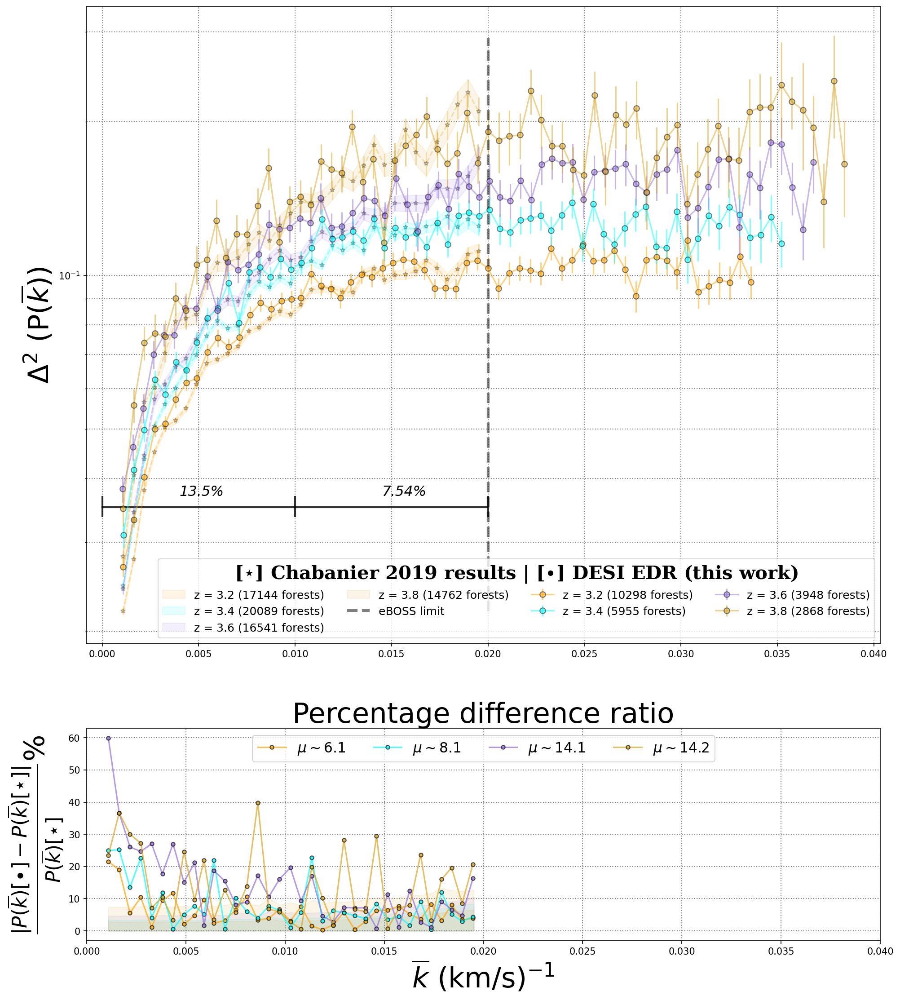

In [129]:
n1, n2 = ['P1D_eBOSS_Chabanier2019_results.fits','P1D_DESI_SC_vel_extent.fits.gz']


local_file1 = os.path.join(local_dir,n1)
p1d_file1 = pyfits.open(local_file1)
PS1 = Table.read(p1d_file1[1])
chunks1 = Table.read(p1d_file1[2])
    
local_file2 = os.path.join(local_dir,n2)
p1d_file2 = pyfits.open(local_file2)
PS2 = Table.read(p1d_file2[1])
chunks2 = Table.read(p1d_file2[2])
bines = 4 - 0
ini = 5
    
fig, axs = plt.subplots(2,1,figsize=(15.2,18), gridspec_kw={'height_ratios': [3,1]}, dpi = 150)
    
for a in range(bines+1):
    if (a==bines):
        axs[0].errorbar(k1,P1,yerr = er1, marker = 'none',
                     label = '',
                     markersize = 0,color = 'none', alpha = 0.0, mec ='none', linestyle = "-")
    else:
        binZ1 = (PS1['zbin'] == z_bin[ini+a])
        pl1 = PS1[binZ1]
        k1 = pl1['meank']
        P1 = (pl1['meanPk'] *  pl1['meank'])/np.pi
        er1 = (pl1['errorPk'] *  pl1['meank'])/np.pi
        fu_1 = ((er1)) + (P1)
        fl_1 = (P1) - ((er1))
        axs[0].errorbar(k1,P1,yerr = er1, marker = '*', 
                        label = '',
                        markersize = 5,color = qlor[ini+a], alpha = 0.3, mec ='k', linestyle = "--") 
        axs[0].fill_between(k1,fu_1,fl_1, alpha = 0.1,color = qlor[ini+a], 
                         label = lbl[ini+a]+' ('+str(int(chunks1['N_chunks'][a]))+ ' forests)')
        
        
    

cut = np.array([60,63,66,69,72,75,78,81,84])
        
for a in range(bines+1):
    if (a==bines):
        axs[0].errorbar(k1,P1,yerr = er1, marker = 'none', 
                     label = '',
                     markersize = 0,color = 'none', alpha = 0.0, mec ='none', linestyle = "-")
    else:
        binZ2 = (PS2['zbin'] == z_bin[ini+a])
        pl2 = PS2[binZ2]
        k2 = pl2['meank']
        P2 = (pl2['meanPk'] *  pl2['meank'])/np.pi
        er2 = (pl2['errorPk'] *  pl2['meank'])/np.pi
        k = k2[0:cut[a]+1]
        P = P2[0:cut[a]+1]
        er = er2[0:cut[a]+1]
        fu_2 = ((er2)) + (P2)
        fl_2 = (P2) - ((er2))
        fu_2 = fu_2[0:cut[a]+1]
        fl_2 = fl_2[0:cut[a]+1]
        axs[0].errorbar(k,P,yerr = er, marker = 'o',
                        label = lbl[ini+a]+' ('+str(int(chunks2['N_chunks'][a]))+ ' forests)',
                        markersize = 6, color = qlor[ini+a], alpha = 0.5, mec ='k', linestyle = "-")
        binZA = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= 2.02)
        plA = PS1[binZA]
        kA = plA['meank']
        PA = (plA['meanPk'] *  plA['meank'])/np.pi
        erA = (plA['errorPk'] *  plA['meank'])/np.pi
        fu_A = ((erA)) + (PA)
        fl_A = (PA) - ((erA))
        EP = abs((plA['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
   


lw_fl = 3
lc_fl = 'black'
a_fl = 0.5


axs[0].axvline(0.020,ymin = 0.05,ymax= 0.95, c=lc_fl, alpha=a_fl, linewidth = lw_fl, 
            label = 'eBOSS limit', linestyle = '--')    
#axs[0].set_title(f'P1D comparison', weight='semibold', 
           #style= 'normal', family = 'serif', size =30)
    
axs[0].set_ylabel('${\Delta}^{2}$ (P($\overline{k}))$', size = 30)
axs[0].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
axs[0].set_xticks([0.000, 0.005, 0.010, 0.015,0.020, 0.025, 0.030,0.035,0.040])
axs[0].set_yscale('log')
    
txt_prop = {'size' :12}
txt_propT = {'style' : 'normal', 'family' : 'serif', 'size' :20, 'weight':'semibold'}
S = r'[$\star$]'
B = r'[$\bullet$]'
axs[0].legend(loc = 'lower right', ncol= 4, prop = txt_prop,
                title_fontproperties=txt_propT,
                title=f'{S} Chabanier 2019 results | {B} DESI EDR (this work)',fancybox=True)
axs[0].axvline(0,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axvline(0.010,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axvline(0.020,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axhline(0.0351,xmin =0.020,xmax= 0.505, c=lc_fl, alpha=0.8, linewidth = 2)

TrB = 0
TrH = 35



AVE_ERROR = []
Pt1 = []
Pt2 = []
        
for a in range(bines):
    binZ1 = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= 0.02) 
    pl1 = PS1[binZ1]
        
    binZ2 = (PS2['zbin'] == z_bin[ini+a]) & (PS2['meank'] <= 0.02)
    pl2 = PS2[binZ2]
    EP = abs((pl2['meanPk'][TrB:TrH]-pl1['meanPk'][TrB:TrH])/pl1['meanPk'][TrB:TrH])*100
    
    Pt1.append(np.mean(np.array(EP[0:18])))
    Pt2.append(np.mean(np.array(EP[18:35])))
    
    
    ave_flab = np.mean(np.array(EP[TrB:TrH]))
    axs[1].plot(k2[TrB:TrH],EP[TrB:TrH], marker = '.', markersize = 8,
                color = qlor[ini+a], alpha = 0.7,
                label = r'$\mu\sim$'+str(round(ave_flab,1)),mec ='k')
    AVE_ERROR.append(ave_flab)
    if (a <= 8):
        BE = abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Base error from the control group
        eb1 = BE + abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Error boundary 1
        eb2 = BE - abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Error boundary 2
        axs[1].fill_between(k1,eb1,eb2, alpha = 0.1,color = qlor[ini+a])
        
AVE_ERROR = np.array(AVE_ERROR)        
Pt1 = np.array(Pt1)       
Pt2 = np.array(Pt2)        
        
axs[1].set_xlabel('$\overline{k}$ (km/s)$^{-1}$', size = 30)
axs[1].set_ylabel(r'$\frac{|P(\overline{k})[\bullet]-P(\overline{k})[\star]|}{P(\overline{k})[\star]}$%', size = 30)
axs[1].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
axs[1].legend(loc = 'upper center', ncol=7, fontsize = 15)
axs[1].set_xticks([0.000, 0.005, 0.010, 0.015,0.020, 0.025, 0.030,0.035,0.040])
plt.title(f'Percentage difference ratio', size = 30)
print(f'Prepared for mean file from Corentin...')
print(f'Average difference {round(np.mean(AVE_ERROR),2)}%')     
print(f'Average difference Pt1 {round(np.mean(Pt1),2)}%')
print(f'Average difference Pt2 {round(np.mean(Pt2),2)}%') 


text_rot = 0.0     


axs[0].text(0.004, 0.037, f'{round(np.mean(Pt1),2)}%', fontsize = 15, 
         bbox = {'facecolor': 'none', 'alpha': 0.3, 'boxstyle': "round,pad=0.3", 'ec': 'none'},
         rotation = text_rot, style = 'oblique') 
axs[0].text(0.0145, 0.037, f'{round(np.mean(Pt2),2)}%', fontsize = 15, 
         bbox = {'facecolor': 'none', 'alpha': 0.3, 'boxstyle': "round,pad=0.3", 'ec': 'none'},
         rotation = text_rot, style = 'oblique') 

plt.savefig('DESIvel-compar2.png', bbox_inches='tight')
plt.show() 

Prepared for mean file from Corentin...
Average difference 9.64%
Average difference Pt1 13.4%
Average difference Pt2 5.66%


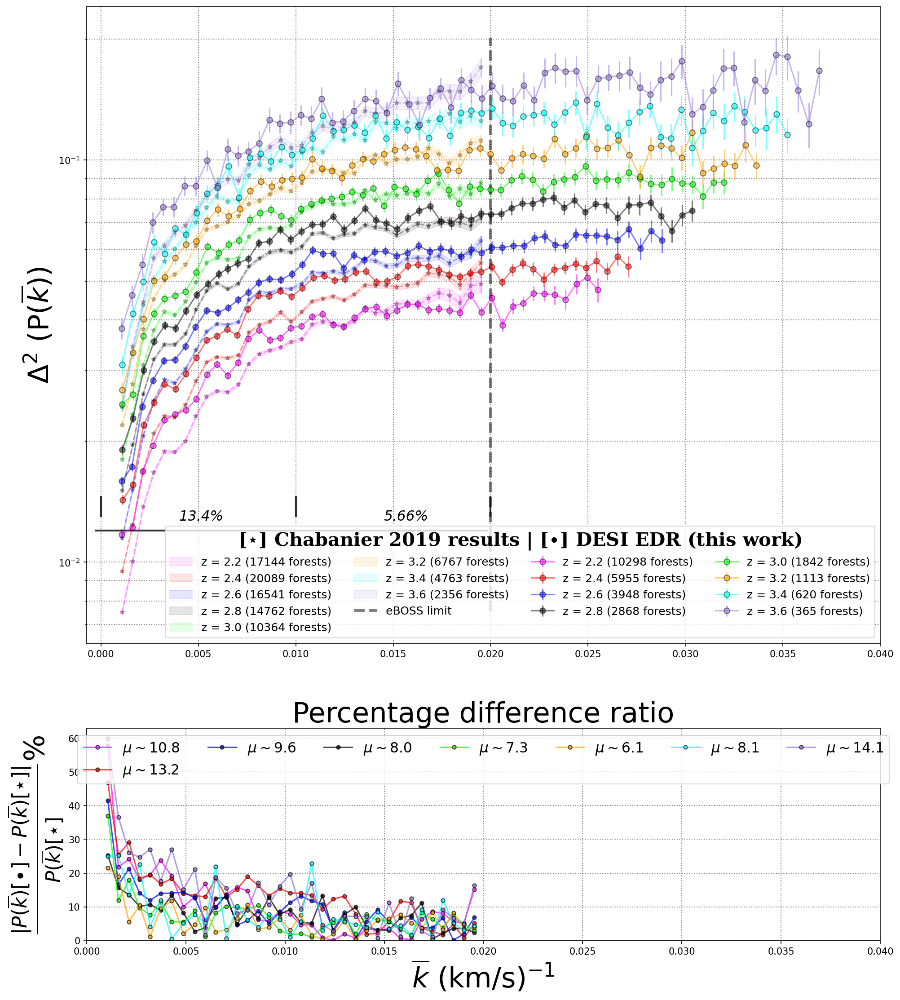

In [5]:
n1, n2 = ['P1D_eBOSS_Chabanier2019_results.fits','P1D_DESI_SC_vel_extent.fits.gz']
#n1, n2 = ['P1D_eBOSS_DR14_Standard-master.fits.gz','P1D_DESI_SC_vel_extent.fits.gz']


local_file1 = os.path.join(local_dir,n1)
p1d_file1 = pyfits.open(local_file1)
PS1 = Table.read(p1d_file1[1])
chunks1 = Table.read(p1d_file1[2])
    
local_file2 = os.path.join(local_dir,n2)
p1d_file2 = pyfits.open(local_file2)
PS2 = Table.read(p1d_file2[1])
chunks2 = Table.read(p1d_file2[2])
bines = 8 - 0
ini = 0
    
fig, axs = plt.subplots(2,1,figsize=(15.2,18), gridspec_kw={'height_ratios': [3,1]}, dpi = 150)
    
for a in range(bines+1):
    if (a==bines):
        axs[0].errorbar(k1,P1,yerr = er1, marker = 'none',
                     label = '',
                     markersize = 0,color = 'none', alpha = 0.0, mec ='none', linestyle = "-")
    else:
        binZ1 = (PS1['zbin'] == z_bin[ini+a])
        pl1 = PS1[binZ1]
        k1 = pl1['meank']
        P1 = (pl1['meanPk'] *  pl1['meank'])/np.pi
        er1 = (pl1['errorPk'] *  pl1['meank'])/np.pi
        fu_1 = ((er1)) + (P1)
        fl_1 = (P1) - ((er1))
        axs[0].errorbar(k1,P1,yerr = er1, marker = '*', 
                        label = '',
                        markersize = 5,color = qlor[ini+a], alpha = 0.3, mec ='k', linestyle = "--") 
        axs[0].fill_between(k1,fu_1,fl_1, alpha = 0.1,color = qlor[ini+a], 
                         label = lbl[ini+a]+' ('+str(int(chunks1['N_chunks'][a]))+ ' forests)')
        
        
    

cut = np.array([45,48,51,54,57,60,63,66,69,72,75,78,81,84])
        
for a in range(bines+1):
    if (a==bines):
        axs[0].errorbar(k1,P1,yerr = er1, marker = 'none', 
                     label = '',
                     markersize = 0,color = 'none', alpha = 0.0, mec ='none', linestyle = "-")
    else:
        binZ2 = (PS2['zbin'] == z_bin[ini+a])
        pl2 = PS2[binZ2]
        k2 = pl2['meank']
        P2 = (pl2['meanPk'] *  pl2['meank'])/np.pi
        er2 = (pl2['errorPk'] *  pl2['meank'])/np.pi
        k = k2[0:cut[a]+1]
        P = P2[0:cut[a]+1]
        er = er2[0:cut[a]+1]
        fu_2 = ((er2)) + (P2)
        fl_2 = (P2) - ((er2))
        fu_2 = fu_2[0:cut[a]+1]
        fl_2 = fl_2[0:cut[a]+1]
        axs[0].errorbar(k,P,yerr = er, marker = 'o',
                        label = lbl[ini+a]+' ('+str(int(chunks2['N_chunks'][a]))+ ' forests)',
                        markersize = 6, color = qlor[ini+a], alpha = 0.5, mec ='k', linestyle = "-")
        binZA = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= 2.02)
        plA = PS1[binZA]
        kA = plA['meank']
        PA = (plA['meanPk'] *  plA['meank'])/np.pi
        erA = (plA['errorPk'] *  plA['meank'])/np.pi
        fu_A = ((erA)) + (PA)
        fl_A = (PA) - ((erA))
        EP = abs((plA['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
   


lw_fl = 3
lc_fl = 'black'
a_fl = 0.5


axs[0].axvline(0.020,ymin = 0.05,ymax= 0.95, c=lc_fl, alpha=a_fl, linewidth = lw_fl, 
            label = 'eBOSS limit', linestyle = '--')    
#axs[0].set_title(f'P1D comparison', weight='semibold', 
            #style= 'normal', family = 'serif', size =30)
    
axs[0].set_ylabel('${\Delta}^{2}$ (P($\overline{k}))$', size = 30)
axs[0].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
axs[0].set_xticks([0.000, 0.005, 0.010, 0.015,0.020, 0.025, 0.030,0.035,0.040])
axs[0].set_yscale('log')
    
txt_prop = {'size' :12}
txt_propT = {'style' : 'normal', 'family' : 'serif', 'size' :20, 'weight':'semibold'}
S = r'[$\star$]'
B = r'[$\bullet$]'
axs[0].legend(loc = 'lower right', ncol= 4, prop = txt_prop,
                title_fontproperties=txt_propT,
                title=f'{S} Chabanier 2019 results | {B} DESI EDR (this work)',fancybox=True)
axs[0].axvline(0,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axvline(0.010,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axvline(0.020,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axhline(0.0120,xmin =0.011,xmax= 0.505, c=lc_fl, alpha=0.8, linewidth = 2)


TrB = 0
TrH = 35



AVE_ERROR = []
Pt1 = []
Pt2 = []
        
for a in range(bines):
    binZ1 = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= 0.02) 
    pl1 = PS1[binZ1]
        
    binZ2 = (PS2['zbin'] == z_bin[ini+a]) & (PS2['meank'] <= 0.02)
    pl2 = PS2[binZ2]
    EP = abs((pl2['meanPk'][TrB:TrH]-pl1['meanPk'][TrB:TrH])/pl1['meanPk'][TrB:TrH])*100
    
    Pt1.append(np.mean(np.array(EP[0:18])))
    Pt2.append(np.mean(np.array(EP[18:35])))
    
    
    ave_flab = np.mean(np.array(EP[TrB:TrH]))
    axs[1].plot(k2[TrB:TrH],EP[TrB:TrH], marker = '.', markersize = 8,
                color = qlor[ini+a], alpha = 0.7,
                label = r'$\mu\sim$'+str(round(ave_flab,1)),mec ='k')
    AVE_ERROR.append(ave_flab)
    if (a <= 8):
        #BE = (abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])+abs(pl2['errorPk'][TrB:TrH]/pl2['meanPk'][TrB:TrH]))/2*100 # Base error from the control group
        #eb1 = (abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])+abs(pl2['errorPk'][TrB:TrH]/pl2['meanPk'][TrB:TrH]))/2*100# Error boundary 1
        #s_lim = EP - eb1  # Surpassing error limit
        #axs[1].plot(k2[TrB:TrH],s_lim, marker = '.', markersize = 8,
                #color = qlor[ini+a], alpha = 0.7,
                #label = r'$\mu\sim$'+str(round(ave_flab,1)),mec ='k')
        BE = abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Base error from the control group
        eb1 = BE + abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Error boundary 1
        eb2 = BE - abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Error boundary 2
        #axs[1].fill_between(k1,eb1,eb2, alpha = 0.1,color = qlor[ini+a])


            
  


                
AVE_ERROR = np.array(AVE_ERROR)        
Pt1 = np.array(Pt1)       
Pt2 = np.array(Pt2)        
        
axs[1].set_xlabel('$\overline{k}$ (km/s)$^{-1}$', size = 30)
axs[1].set_ylabel(r'$\frac{|P(\overline{k})[\bullet]-P(\overline{k})[\star]|}{P(\overline{k})[\star]}$%', size = 30)
axs[1].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
axs[1].legend(loc = 'upper center', ncol=7, fontsize = 15)
axs[1].set_xticks([0.000, 0.005, 0.010, 0.015,0.020, 0.025, 0.030,0.035,0.040])
axs[1].set_ylim(0)
plt.title(f'Percentage difference ratio', size = 30)
print(f'Prepared for mean file from Corentin...')
print(f'Average difference {round(np.mean(AVE_ERROR),2)}%')     
print(f'Average difference Pt1 {round(np.mean(Pt1),2)}%')
print(f'Average difference Pt2 {round(np.mean(Pt2),2)}%') 


text_rot = 0.0     


axs[0].text(0.004, 0.0127, f'{round(np.mean(Pt1),2)}%', fontsize = 15, 
         bbox = {'facecolor': 'none', 'alpha': 0.3, 'boxstyle': "round,pad=0.3", 'ec': 'none'},
         rotation = text_rot, style = 'oblique') 
axs[0].text(0.0145, 0.0127, f'{round(np.mean(Pt2),2)}%', fontsize = 15, 
         bbox = {'facecolor': 'none', 'alpha': 0.3, 'boxstyle': "round,pad=0.3", 'ec': 'none'},
         rotation = text_rot, style = 'oblique') 

plt.savefig('DESIvel-compar1.png', bbox_inches='tight')
plt.show() 

# DESI comparisons (vel by hand)

In [137]:
def l_vK(L,z):
    c = 300000 #km/s
    lya = 1215.67
    V = L * (lya*(1+z)/c)
    return V

Prepared for mean file from Corentin...
Average difference 6.93%
Average difference Pt1 8.03%
Average difference Pt2 5.77%


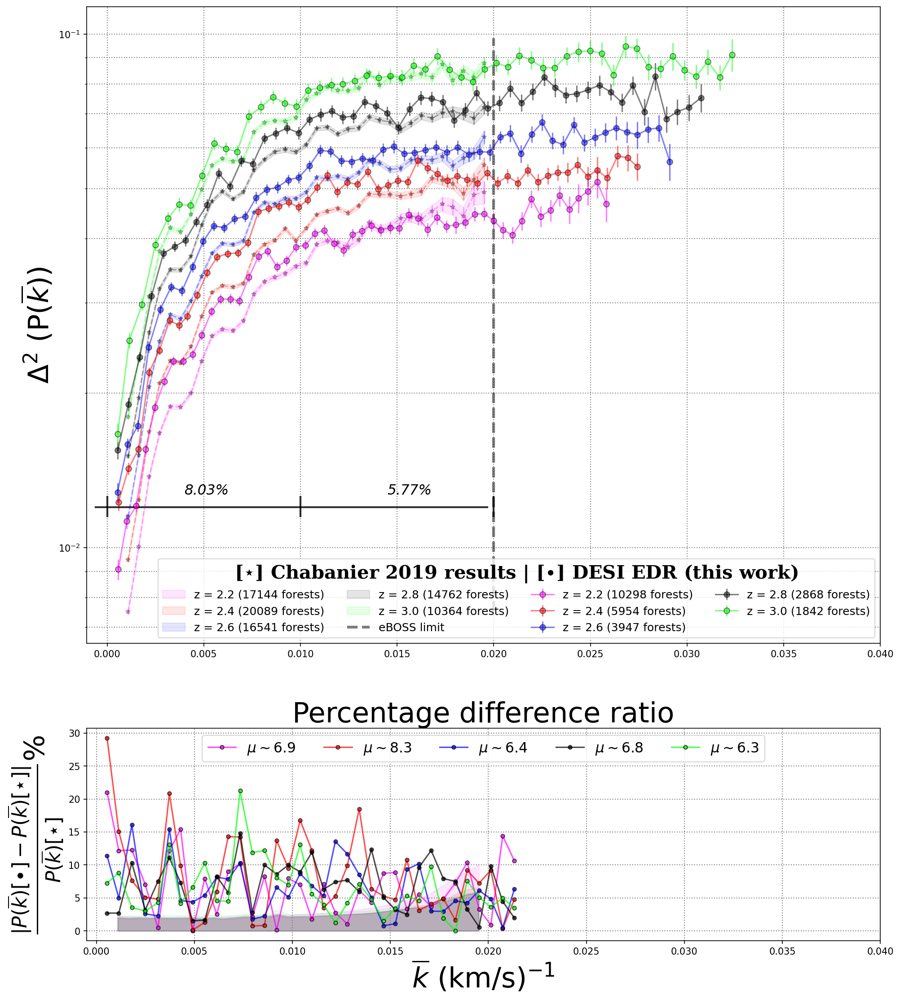

In [138]:
n1, n2 = ['P1D_eBOSS_Chabanier2019_results.fits','P1D_DESI_SC.fits.gz']
#n1, n2 = ['P1D_eBOSS_DR14_Standard-master.fits.gz','P1D_DESI_SC_vel_extent.fits.gz']


local_file1 = os.path.join(local_dir,n1)
p1d_file1 = pyfits.open(local_file1)
PS1 = Table.read(p1d_file1[1])
chunks1 = Table.read(p1d_file1[2])
    
local_file2 = os.path.join(local_dir,n2)
p1d_file2 = pyfits.open(local_file2)
PS2 = Table.read(p1d_file2[1])
chunks2 = Table.read(p1d_file2[2])
bines = 5 - 0
ini = 0
    
fig, axs = plt.subplots(2,1,figsize=(15.2,18), gridspec_kw={'height_ratios': [3,1]}, dpi = 150)
    
for a in range(bines+1):
    if (a==bines):
        axs[0].errorbar(k1,P1,yerr = er1, marker = 'none',
                     label = '',
                     markersize = 0,color = 'none', alpha = 0.0, mec ='none', linestyle = "-")
    else:
        binZ1 = (PS1['zbin'] == z_bin[ini+a])
        pl1 = PS1[binZ1]
        k1 = pl1['meank']
        P1 = (pl1['meanPk'] *  pl1['meank'])/np.pi
        er1 = (pl1['errorPk'] *  pl1['meank'])/np.pi
        fu_1 = ((er1)) + (P1)
        fl_1 = (P1) - ((er1))
        axs[0].errorbar(k1,P1,yerr = er1, marker = '*', 
                        label = '',
                        markersize = 5,color = qlor[ini+a], alpha = 0.3, mec ='k', linestyle = "--") 
        axs[0].fill_between(k1,fu_1,fl_1, alpha = 0.1,color = qlor[ini+a], 
                         label = lbl[ini+a]+' ('+str(int(chunks1['N_chunks'][a]))+ ' forests)')
        
        
    

cut = np.array([45,48,51,54,57,60,63,66,69,72,75,78,81,84])
        
for a in range(bines+1):
    if (a==bines):
        axs[0].errorbar(k1,P1,yerr = er1, marker = 'none', 
                     label = '',
                     markersize = 0,color = 'none', alpha = 0.0, mec ='none', linestyle = "-")
    else:
        binZ2 = (PS2['zbin'] == z_bin[ini+a]) & (PS2['meank'] <= 2.02)
        pl2 = PS2[binZ2]
        k2 = l_vK(pl2['meank'],z_bin[ini+a])
        P2 = (pl2['meanPk'] *  pl2['meank'])/np.pi
        er2 = (pl2['errorPk'] *  pl2['meank'])/np.pi
        #k = k2[0:cut[a]+1]
        #P = P2[0:cut[a]+1]
        #er = er2[0:cut[a]+1]
        fu_2 = ((er2)) + (P2)
        fl_2 = (P2) - ((er2))
        #fu_2 = fu_2[0:cut[a]+1]
        #fl_2 = fl_2[0:cut[a]+1]
        axs[0].errorbar(k2,P2,yerr = er2, marker = 'o',
                        label = lbl[ini+a]+' ('+str(int(chunks2['N_chunks'][a]))+ ' forests)',
                        markersize = 6, color = qlor[ini+a], alpha = 0.5, mec ='k', linestyle = "-")
        binZA = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= 2.02)
        plA = PS1[binZA]
        kA = plA['meank']
        PA = (plA['meanPk'] *  plA['meank'])/np.pi
        erA = (plA['errorPk'] *  plA['meank'])/np.pi
        fu_A = ((erA)) + (PA)
        fl_A = (PA) - ((erA))
        EP = abs((plA['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
   


lw_fl = 3
lc_fl = 'black'
a_fl = 0.5


axs[0].axvline(0.020,ymin = 0.05,ymax= 0.95, c=lc_fl, alpha=a_fl, linewidth = lw_fl, 
            label = 'eBOSS limit', linestyle = '--')    
#axs[0].set_title(f'P1D comparison', weight='semibold', 
            #style= 'normal', family = 'serif', size =30)
    
axs[0].set_ylabel('${\Delta}^{2}$ (P($\overline{k}))$', size = 30)
axs[0].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
axs[0].set_xticks([0.000, 0.005, 0.010, 0.015,0.020, 0.025, 0.030,0.035,0.040])
axs[0].set_yscale('log')
    
txt_prop = {'size' :12}
txt_propT = {'style' : 'normal', 'family' : 'serif', 'size' :20, 'weight':'semibold'}
S = r'[$\star$]'
B = r'[$\bullet$]'
axs[0].legend(loc = 'lower right', ncol= 4, prop = txt_prop,
                title_fontproperties=txt_propT,
                title=f'{S} Chabanier 2019 results | {B} DESI EDR (this work)',fancybox=True)
axs[0].axvline(0,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axvline(0.010,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axvline(0.020,ymin =0.20,ymax= 0.23, c=lc_fl, alpha=0.8, linewidth = 2)
axs[0].axhline(0.0120,xmin =0.011,xmax= 0.505, c=lc_fl, alpha=0.8, linewidth = 2)

TrB = 0
TrH = 35



AVE_ERROR = []
Pt1 = []
Pt2 = []
        
for a in range(bines):
    binZ1 = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= 0.02) 
    pl1 = PS1[binZ1]
    A_e = (pl1['meanPk'] *  pl1['meank'])/np.pi
        
    binZ2 = (PS2['zbin'] == z_bin[ini+a]) & (PS2['meank'] <= 2.02)
    pl2 = PS2[binZ2]
    B_e = (pl2['meanPk'] *  pl2['meank'])/np.pi
    
    EP = abs((B_e[TrB:TrH]-A_e[TrB:TrH])/A_e[TrB:TrH])*100
    
    Pt1.append(np.mean(np.array(EP[0:18])))
    Pt2.append(np.mean(np.array(EP[18:35])))
    
    
    ave_flab = np.mean(np.array(EP[TrB:TrH]))
    axs[1].plot(k2[TrB:TrH],EP[TrB:TrH], marker = '.', markersize = 8,
                color = qlor[ini+a], alpha = 0.7,
                label = r'$\mu\sim$'+str(round(ave_flab,1)),mec ='k')
    AVE_ERROR.append(ave_flab)
    if (a <= 8):
        BE = abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Base error from the control group
        eb1 = BE + abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Error boundary 1
        eb2 = BE - abs(pl1['errorPk'][TrB:TrH]/pl1['meanPk'][TrB:TrH])*100 # Error boundary 2
        axs[1].fill_between(k1,eb1,eb2, alpha = 0.1,color = qlor[ini+a])
        
                
AVE_ERROR = np.array(AVE_ERROR)        
Pt1 = np.array(Pt1)       
Pt2 = np.array(Pt2)        
        
axs[1].set_xlabel('$\overline{k}$ (km/s)$^{-1}$', size = 30)
axs[1].set_ylabel(r'$\frac{|P(\overline{k})[\bullet]-P(\overline{k})[\star]|}{P(\overline{k})[\star]}$%', size = 30)
axs[1].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
axs[1].legend(loc = 'upper center', ncol=7, fontsize = 15)
axs[1].set_xticks([0.000, 0.005, 0.010, 0.015,0.020, 0.025, 0.030,0.035,0.040])
plt.title(f'Percentage difference ratio', size = 30)
print(f'Prepared for mean file from Corentin...')
print(f'Average difference {round(np.mean(AVE_ERROR),2)}%')     
print(f'Average difference Pt1 {round(np.mean(Pt1),2)}%')
print(f'Average difference Pt2 {round(np.mean(Pt2),2)}%') 


text_rot = 0.0     


axs[0].text(0.004, 0.0127, f'{round(np.mean(Pt1),2)}%', fontsize = 15, 
         bbox = {'facecolor': 'none', 'alpha': 0.3, 'boxstyle': "round,pad=0.3", 'ec': 'none'},
         rotation = text_rot, style = 'oblique') 
axs[0].text(0.0145, 0.0127, f'{round(np.mean(Pt2),2)}%', fontsize = 15, 
         bbox = {'facecolor': 'none', 'alpha': 0.3, 'boxstyle': "round,pad=0.3", 'ec': 'none'},
         rotation = text_rot, style = 'oblique') 

plt.savefig('DESIvel-compar(vel by hand).png', bbox_inches='tight')
plt.show() 

# Errors new approach

## Error compar eBOSS

In [290]:
def error_compar2NewApproach(n1,n2,ini,fin,Hr1,Hr2,Wf,Hf,title1,title2,eFB=8,name='Def'):

    while (ini>13):
        ini = input('Must be minor than 13:')
        ini = int(ini)
         
    local_file1 = os.path.join(local_dir,n1)
    p1d_file1 = pyfits.open(local_file1)
    PS1 = Table.read(p1d_file1[1])
    chunks1 = Table.read(p1d_file1[2])
    
    local_file2 = os.path.join(local_dir,n2)
    p1d_file2 = pyfits.open(local_file2)
    PS2 = Table.read(p1d_file2[1])
    chunks2 = Table.read(p1d_file2[2])
    
    
    bines = fin - ini
    
    
    fig, axs = plt.subplots(2,1,figsize=(Wf,Hf), gridspec_kw={'height_ratios': [Hr1, Hr2]}, dpi = 150)
        
    for a in range(bines):
        binZ1 = (PS1['zbin'] == z_bin[ini+a])
        pl1 = PS1[binZ1]
        k1 = pl1['meank']
        P1 = (pl1['meanPk'] *  pl1['meank'])/np.pi # Error boundary 1
        er1 = (pl1['errorPk'] *  pl1['meank'])/np.pi # Error boundary 2
        fu_1 = ((er1)) + (P1)
        fl_1 = (P1) - ((er1))
        axs[0].errorbar(k1,P1,yerr = er1, marker = '*', 
                        label = lbl[ini+a]+' ('+str(int(chunks1['N_chunks'][a]))+ ' forests)',
                        markersize = 7,color = qlor[ini+a], alpha = 0.7, mec ='k', linestyle = "--") 
        axs[0].fill_between(k1,fu_1,fl_1, alpha = 0.1)
        
    for a in range(bines):
        binZ2 = (PS2['zbin'] == z_bin[ini+a])
        pl2 = PS2[binZ2]
        k2 = pl2['meank']
        P2 = (pl2['meanPk'] *  pl2['meank'])/np.pi # Error boundary 1
        er2 = (pl2['errorPk'] *  pl2['meank'])/np.pi # Error boundary 2
        fu_2 = ((er2)) + (P2)
        fl_2 = (P2) - ((er2))
        EP = abs((pl2['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
        
        axs[0].errorbar(k2,P2,yerr = er2, marker = 'o', 
                        label = lbl[ini+a]+' ('+str(int(chunks2['N_chunks'][a]))+ ' forests)',
                        markersize = 8, color = qlor[ini+a], alpha = 0.6, mec ='k', linestyle = "-")
        axs[0].fill_between(k2,fu_2,fl_2, alpha = 0.1)
    
    
    AVE_ERROR = []
        
    for a in range(bines):
        binZ1 = (PS1['zbin'] == z_bin[ini+a])
        pl1 = PS1[binZ1]
        
        binZ2 = (PS2['zbin'] == z_bin[ini+a])
        pl2 = PS2[binZ2]
        EP = abs((pl2['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
        ave_flab = np.mean(np.array(EP))
        BE = (abs(pl1['errorPk']/pl1['meanPk'])+abs(pl2['errorPk']/pl2['meanPk']))/2*100 # Base error from the control group
        eb1 = (abs(pl1['errorPk']/pl1['meanPk'])+abs(pl2['errorPk']/pl2['meanPk']))/2*100# Error boundary 1
        s_lim = EP - eb1  # Surpassing error limit

        
        axs[1].plot(k2,s_lim, marker = '.', markersize = 8,
                    color = qlor[ini+a], alpha = 0.7,
                    label = r'$\mu\sim$'+str(round(ave_flab,1)),mec ='k')
        AVE_ERROR.append(ave_flab)
        #if (a <= eFB):
            #BE = abs(pl1['errorPk']/pl1['meanPk'])*100 # Base error from the control group
            #eb1 = BE + abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 1
            #eb2 = BE - abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 2
            #axs[1].fill_between(k2,eb1,eb2, alpha = 0.1, color = qlor[ini+a])
                    
    AVE_ERROR = np.array(AVE_ERROR)
    
    
    #axs[0].set_title(f'{TITLE}', weight='semibold', 
                #style= 'normal', family = 'serif', size =30)
    
    axs[0].set_ylabel('${\Delta}^{2}$ (P($\overline{k}))$', size = 30)
    axs[0].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
    axs[0].set_xticks([0.001, 0.002, 0.004, 0.006,0.008, 0.010, 0.012,0.014,0.016,0.018,0.020])
    axs[0].set_yscale('log')
    
    
    txt_prop = {'size' :12}
    txt_propT = {'style' : 'normal', 'family' : 'serif', 'size' :20, 'weight':'semibold'}
    
    S = r'[$\star$]'
    B = r'[$\bullet$]'
    
    
    axs[0].legend(loc = 'lower right', ncol= 4, prop = txt_prop,
                  title_fontproperties=txt_propT,
                  title=f'{S} {title1} | {B} {title2}')

    
    
    

    axs[1].set_xlabel('$\overline{k}$ (km/s)$^{-1}$', size = 30)
    axs[1].set_ylabel(r'$\frac{|P(\overline{k})[\bullet]-P(\overline{k})[\star]|}{P(\overline{k})[\star]}$%', size = 30)
    axs[1].set_ylim(0)
    axs[1].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
    axs[1].legend(loc = 'upper center', ncol=7, fontsize = 12)
    plt.title(f'Percentage difference ratio', size = 30)
    print(f'Average difference {round(np.mean(AVE_ERROR),2)}%')
    plt.savefig(name, bbox_inches='tight')
    plt.show()

Average difference 4.45%


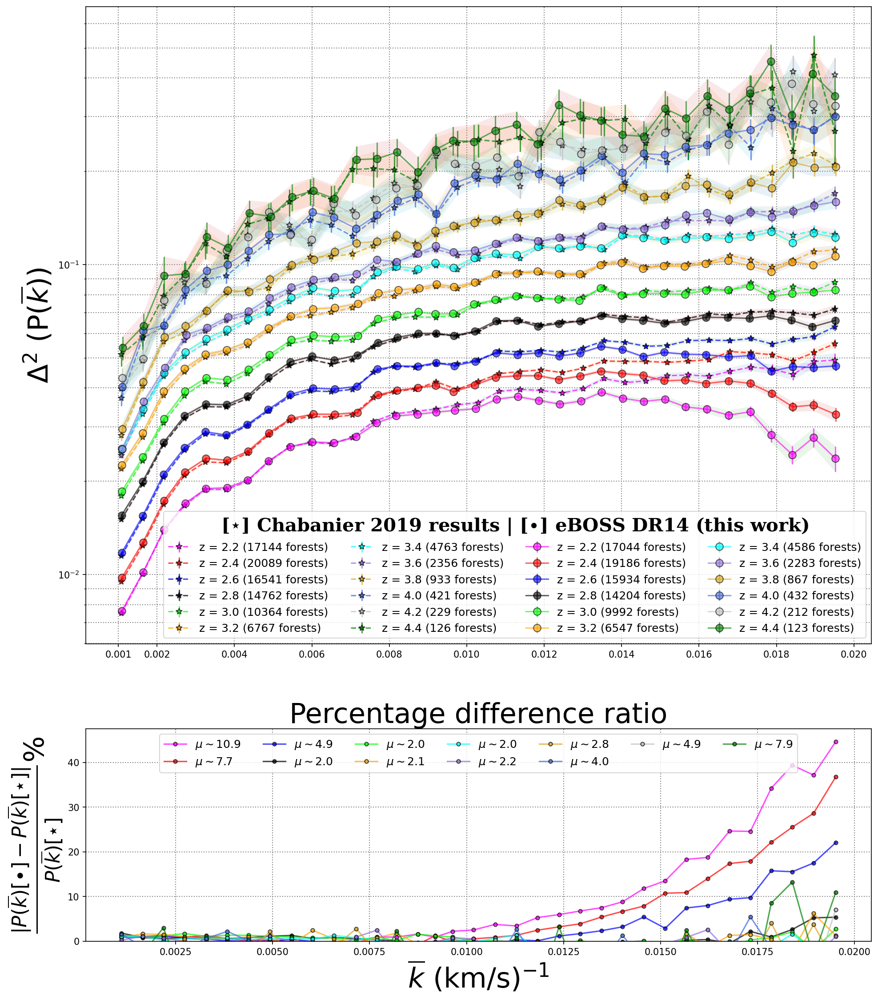

In [307]:

error_compar2NewApproach('P1D_eBOSS_Chabanier2019_results.fits','P1D_eBOSS_DR14_Standard-v4.fits.gz',
              0,12,3,1,15.2,18.2,
              'Chabanier 2019 results','eBOSS DR14 (this work)',0,'Chabanier compar.png')

Average difference 4.13%


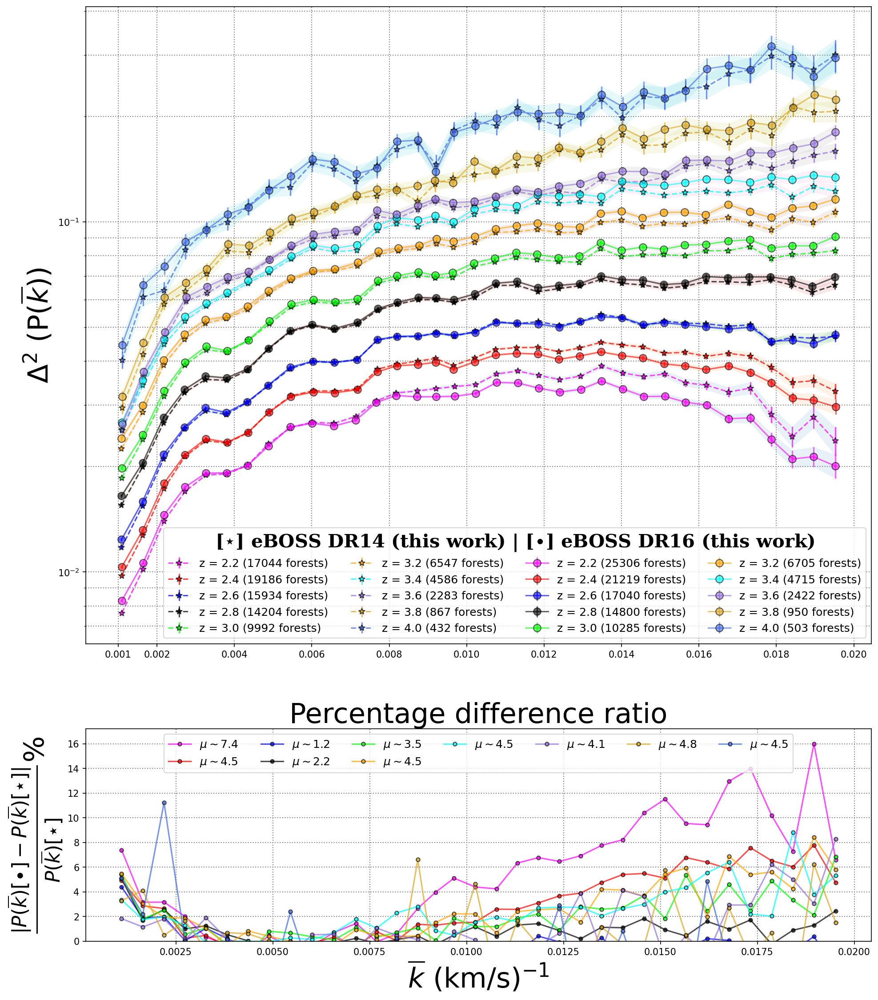

In [308]:
error_compar2NewApproach('P1D_eBOSS_DR14_Standard-v4.fits.gz','P1D_eBOSS_DR16_Standard-v4.fits.gz',
              0,10,3,1,15.2,18.2,
              'eBOSS DR14 (this work)','eBOSS DR16 (this work)',6,'eBOSS compar.png')

## Error compar DESI

In [293]:
def error_compar2_lambdaNewApproach(n1,n2,ini,fin,Hr1,Hr2,Wf,Hf,title1,title2,eFB=8,name='Def'):

    while (ini>13):
        ini = input('Must be minor than 13:')
        ini = int(ini)
         
    local_file1 = os.path.join(local_dir,n1)
    p1d_file1 = pyfits.open(local_file1)
    PS1 = Table.read(p1d_file1[1])
    chunks1 = Table.read(p1d_file1[2])
    
    local_file2 = os.path.join(local_dir,n2)
    p1d_file2 = pyfits.open(local_file2)
    PS2 = Table.read(p1d_file2[1])
    chunks2 = Table.read(p1d_file2[2])
    
    
    bines = fin - ini
    
    
    fig, axs = plt.subplots(2,1,figsize=(Wf,Hf), gridspec_kw={'height_ratios': [Hr1, Hr2]}, dpi = 150)
        
    for a in range(bines):
        binZ1 = (PS1['zbin'] == z_bin[ini+a])  & (PS1['meank'] <= 2.02)
        pl1 = PS1[binZ1]
        k1 = pl1['meank']
        P1 = (pl1['meanPk'] *  pl1['meank'])/np.pi
        er1 = (pl1['errorPk'] *  pl1['meank'])/np.pi
        fu_1 = ((er1)) + (P1)
        fl_1 = (P1) - ((er1))
        axs[0].errorbar(k1,P1,yerr = er1, marker = '*', 
                        label = lbl[ini+a]+' ('+str(int(chunks1['N_chunks'][a+ini]))+ ' forests)',
                        markersize = 6,color = qlor[ini+a], alpha = 0.7, mec ='k', linestyle = "--") 
        axs[0].fill_between(k1,fu_1,fl_1, alpha = 0.1)
        
    for a in range(bines):
        binZ2 = (PS2['zbin'] == z_bin[ini+a]) & (PS2['meank'] <= 2.02)
        pl2 = PS2[binZ2]
        k2 = pl2['meank']
        P2 = (pl2['meanPk'] *  pl2['meank'])/np.pi
        er2 = (pl2['errorPk'] *  pl2['meank'])/np.pi
        fu_2 = ((er2)) + (P2)
        fl_2 = (P2) - ((er2))
        EP = abs((pl2['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
        
        axs[0].errorbar(k2,P2,yerr = er2, marker = 'o', 
                        label = lbl[ini+a]+' ('+str(int(chunks2['N_chunks'][a+ini]))+ ' forests)',
                        markersize = 6, color = qlor[ini+a], alpha = 0.6, mec ='k', linestyle = "-")
        axs[0].fill_between(k2,fu_2,fl_2, alpha = 0.1)
    
    
    AVE_ERROR = []
        
    for a in range(bines):
        binZ1 = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= 2.02)
        pl1 = PS1[binZ1]

        k2 = pl2['meank']
        binZ2 = (PS2['zbin'] == z_bin[ini+a]) & (PS2['meank'] <= 2.02)
        pl2 = PS2[binZ2]
        EP = abs((pl2['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
        ave_flab = np.mean(np.array(EP))
        #BE = abs(pl1['errorPk']/pl1['meanPk'])*100 # Base error from the control group
        #eb1 = BE + abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 1
        BE = (abs(pl1['errorPk']/pl1['meanPk'])+abs(pl2['errorPk']/pl2['meanPk']))/2*100 # Base error from the control group
        eb1 = (abs(pl1['errorPk']/pl1['meanPk'])+abs(pl2['errorPk']/pl2['meanPk']))/2*100# Error boundary 1
        s_lim = EP - eb1  # Surpassing error limit

        
        axs[1].plot(k2,s_lim, marker = '.', markersize = 8,
                    color = qlor[ini+a], alpha = 0.7,
                    label = r'$\mu\sim$'+str(round(ave_flab,1)),mec ='k')
        AVE_ERROR.append(ave_flab)
        #if (a <= eFB):
            #BE = abs(pl1['errorPk']/pl1['meanPk'])*100 # Base error from the control group
            #eb1 = BE + abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 1
            #eb2 = BE - abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 2
            #axs[1].fill_between(k2,eb1,eb2, alpha = 0.1, color = qlor[ini+a])
        
    AVE_ERROR = np.array(AVE_ERROR)
    
    
    #axs[0].set_title(f'{TITLE}', weight='semibold', 
                #style= 'normal', family = 'serif', size =30)
    
    axs[0].set_ylabel('${\Delta}^{2}$ (P($\overline{k}))$', size = 30)
    axs[0].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
    axs[0].set_xticks([0.0,0.25,0.50,0.75,1.0,1.25,1.50,1.75,2.0])
    axs[0].set_yscale('log')
    
    
    txt_prop = {'size' :13}
    txt_propT = {'style' : 'normal', 'family' : 'serif', 'size' :17, 'weight':'semibold'}
    
    S = r'[$\star$]'
    B = r'[$\bullet$]'
    
    
    axs[0].legend(loc = 'lower right', ncol= 2, prop = txt_prop,
                  title_fontproperties=txt_propT,
                  title=f'{S} {title1} | {B} {title2}')

    
    
    

    axs[1].set_xlabel('$\overline{k}$ $(\AA^{-1})$', size = 30)
    axs[1].set_ylabel(r'$\frac{|P(\overline{k})[\bullet]-P(\overline{k})[\star]|}{P(\overline{k})[\star]}$%', size = 30)
    axs[1].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
    axs[1].legend(loc = 'upper center', ncol=7, fontsize = 15)
    axs[1].set_ylim(0)
    plt.title(f'Percentage difference ratio', size = 30)
    print(f'Prepared for mean file from Corentin...')
    print(f'Average difference {round(np.mean(AVE_ERROR),2)}%')
    plt.savefig(name, bbox_inches='tight')
    plt.show()

Prepared for mean file from Corentin...
Average difference 4.69%


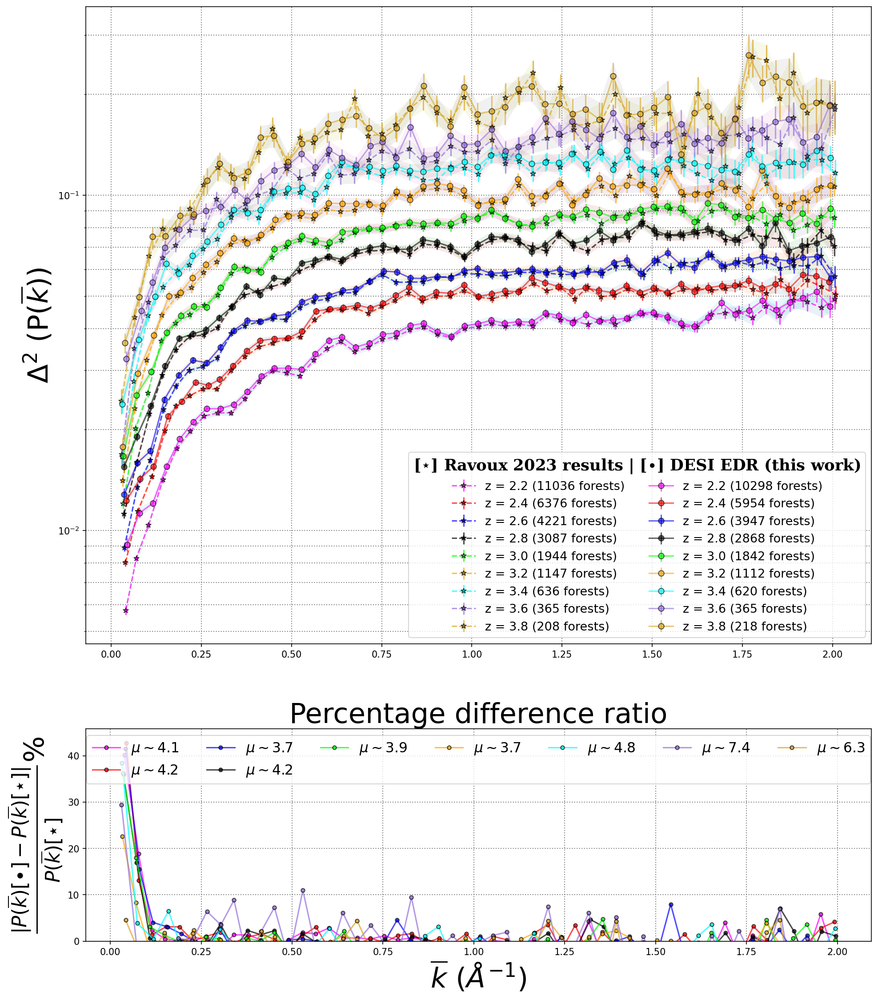

In [294]:
error_compar2_lambdaNewApproach('mean_Pk1d_fit_snr_medians.fits.gz','P1D_DESI_SC.fits.gz',
              0,9,3,1,15.2,18.2,
              'Ravoux 2023 results','DESI EDR (this work)',5,'DESI compar.png')

## Systematics NA

In [309]:
def systematicsNA(n1,n2,ini,fin,Hr1,Hr2,Wf,Hf,title,eFB=8,name='Def'):

    while (ini>13):
        ini = input('Must be minor than 13:')
        ini = int(ini)
        
    local_file1 = os.path.join(local_dir,n1)
    PS1=Table.read(local_file1)
    
    print(n1)
    bines = fin - ini
    
    fig, axs = plt.subplots(len(n2),1,figsize=(Wf,Hf),gridspec_kw={'hspace':0.3}, dpi = 150)#, gridspec_kw={'height_ratios': [Hr1, Hr2]}
    
    marks = ['o','*','s']
    
    boundary = 0
    
    if (((np.char.find(title, "DESI", start=0, end=None))>=0)):
        boundary = 2.05
    else:
        boundary = 0.02
  
    for h in range(len(n2)):

        print(n2[h])
        local_file2 = os.path.join(local_dir,n2[h])
        PS2=Table.read(local_file2)
        
        if ((np.char.find(n2[h], "DLA", start=0, end=None))>=0):
            budget_name = "Skipping DLA corrections"
        elif ((np.char.find(n2[h], "BAL", start=0, end=None))>=0):
            budget_name = "Including BAL quasars in the computation"
        elif ((np.char.find(n2[h], "Sky", start=0, end=None))>=0):
            budget_name = "Skipping skylines masking"
        
        
        for a in range(bines):
            binZ1 = (PS1['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= boundary)
            pl1 = PS1[binZ1]
            k1 = pl1['meank']
            P1 = (pl1['meanPk'] *  pl1['meank'])/np.pi
            er1 = (pl1['errorPk'] *  pl1['meank'])/np.pi
            fu_1 = ((er1)) + (P1)
            fl_1 = (P1) - ((er1))
            
            binZ2 = (PS2['zbin'] == z_bin[ini+a]) & (PS1['meank'] <= boundary)
            pl2 = PS2[binZ2]
            k2 = pl2['meank']
            P2 = (pl2['meanPk'] *  pl2['meank'])/np.pi
            er2 = (pl2['errorPk'] *  pl2['meank'])/np.pi
            fu_2 = ((er2)) + (P2)
            fl_2 = (P2) - ((er2))
            EP = abs((pl2['meanPk']-pl1['meanPk'])/pl1['meanPk'])*100
            BE = (abs(pl1['errorPk']/pl1['meanPk'])+abs(pl2['errorPk']/pl2['meanPk']))/2*100 # Base error from the control group
            eb1 = (abs(pl1['errorPk']/pl1['meanPk'])+abs(pl2['errorPk']/pl2['meanPk']))/2*100# Error boundary 1
            #BE = abs(pl1['errorPk']/pl1['meanPk'])*100 # Base error from the control group
            #eb1 = BE + abs(pl1['errorPk']/pl1['meanPk'])*100 # Error boundary 1
            s_lim = EP - eb1  # Surpassing error limit
            axs[h].plot(k2,s_lim, marker = marks[h], markersize = 8,color = qlor[ini+a], 
                        alpha = 0.7, mec ='k',label = lbl[ini+a])        

        
            
        
        axs[h].set_ylabel(r'$\frac{|P(\overline{k})-{P}_{control}(\overline{k})|}{{P}_{control}(\overline{k})}$%', size = 30)
        axs[h].grid(True, which="both", ls=":", color = 'gray', linewidth = 1)
        axs[h].set_title(f'{budget_name}', size = 20)
        txt_prop = {'style' : 'italic'}
        axs[h].legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=1, prop = txt_prop) #lbl[ini:fin]
        axs[h].set_ylim(-5)


        
        if (((np.char.find(title, "DESI", start=0, end=None))>=0)):
            axs[h].set_xticks([0.0,0.25,0.50,0.75,1.0,1.25,1.50,1.75,2.0])
            axs[h].set_xlim([0.0,2.0])
        else:
            axs[h].set_xticks([0.001, 0.002, 0.004, 0.006,0.008, 0.010, 0.012,0.014,0.016,0.018,0.020])
            axs[h].set_xlim([0.0,0.02])
         
        if ((h==2) and ((np.char.find(title, "BOSS", start=0, end=None))>=0)):
            axs[h].set_xlabel('$\overline{k}$ (km/s)$^{-1}$', size = 30)
            plt.savefig(name, bbox_inches='tight')
            print('eBOSS MODE')
            
        if ((h==1) and ((np.char.find(title, "DESI", start=0, end=None))>=0)):
            axs[h].set_xlabel('$\overline{k}$ $(\AA^{-1})$', size = 30)
            plt.savefig(name, bbox_inches='tight')
            print('DESI MODE')


P1D_DESI_Standard.fits.gz
P1D_DESI_BALsincu.fits.gz
P1D_DESI_Skynocor.fits.gz
DESI MODE


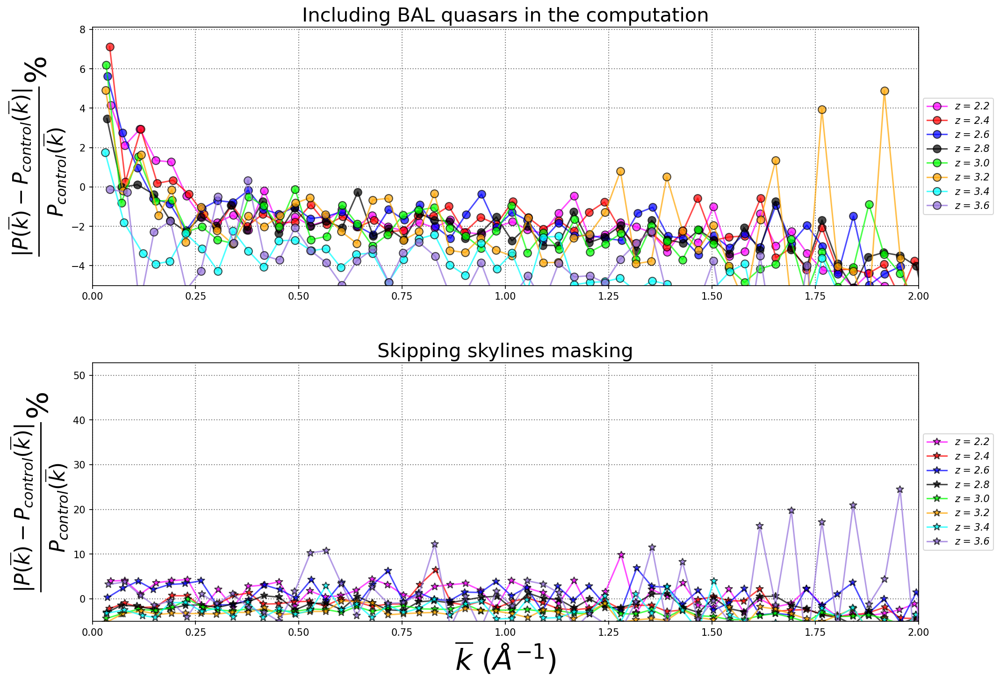

In [320]:
systematicsNA('P1D_DESI_Standard.fits.gz',
                  ['P1D_DESI_BALsincu.fits.gz','P1D_DESI_Skynocor.fits.gz'],
                  0,8,3,1,15.2,11,'DESI EDR',2,'Sistems DESI EDR.png')

P1D_eBOSS_DR14_Standard-master.fits.gz
P1D_eBOSS_DR14_DLAnot_corrected.fits.gz
P1D_eBOSS_DR14_BALincluded.fits.gz
P1D_eBOSS_DR14_SkyLines_included.fits.gz
eBOSS MODE


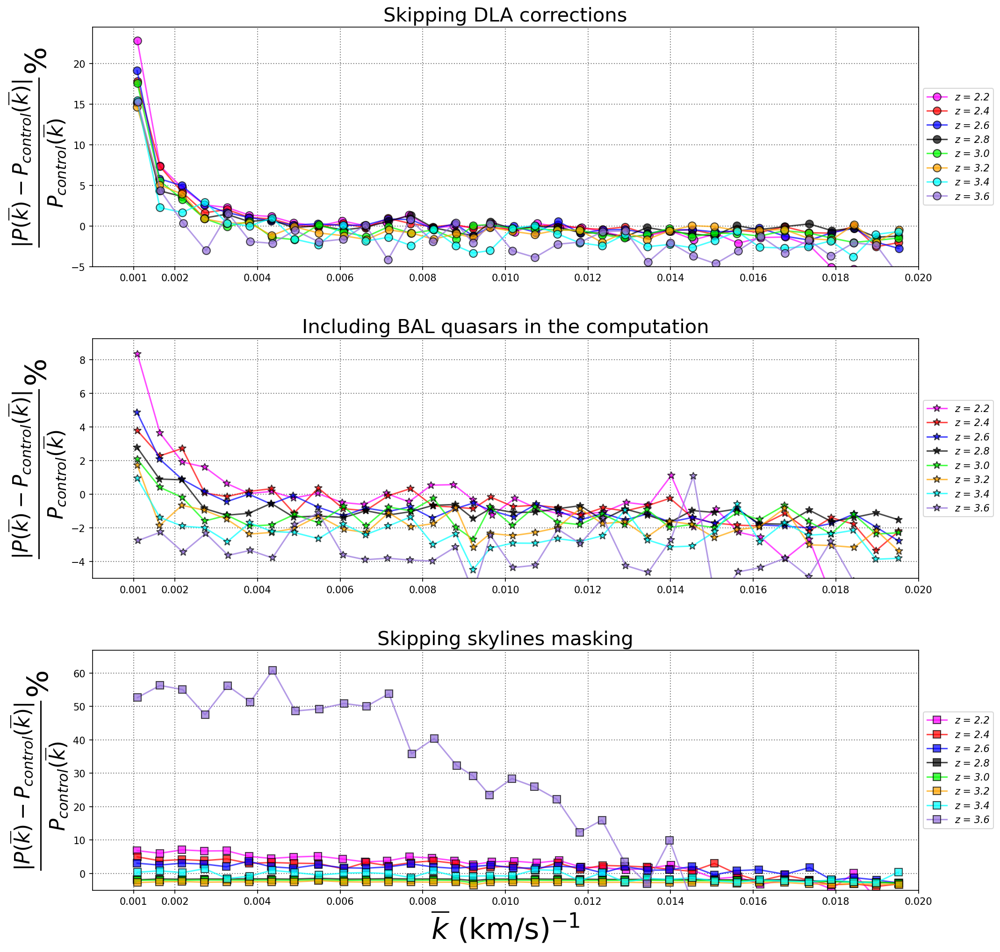

In [321]:
systematicsNA('P1D_eBOSS_DR14_Standard-master.fits.gz',
                  ['P1D_eBOSS_DR14_DLAnot_corrected.fits.gz','P1D_eBOSS_DR14_BALincluded.fits.gz',
                   'P1D_eBOSS_DR14_SkyLines_included.fits.gz'],
                  0,8,3,1,15.2,16,'eBOSS DR14',5,'Sistems DR14.png')

P1D_eBOSS_DR16_Standard-master.fits.gz
P1D_eBOSS_DR16_DLAnot_corrected.fits.gz
P1D_eBOSS_DR16_BALincluded.fits.gz
P1D_eBOSS_DR16_SkyLines_included.fits.gz
eBOSS MODE


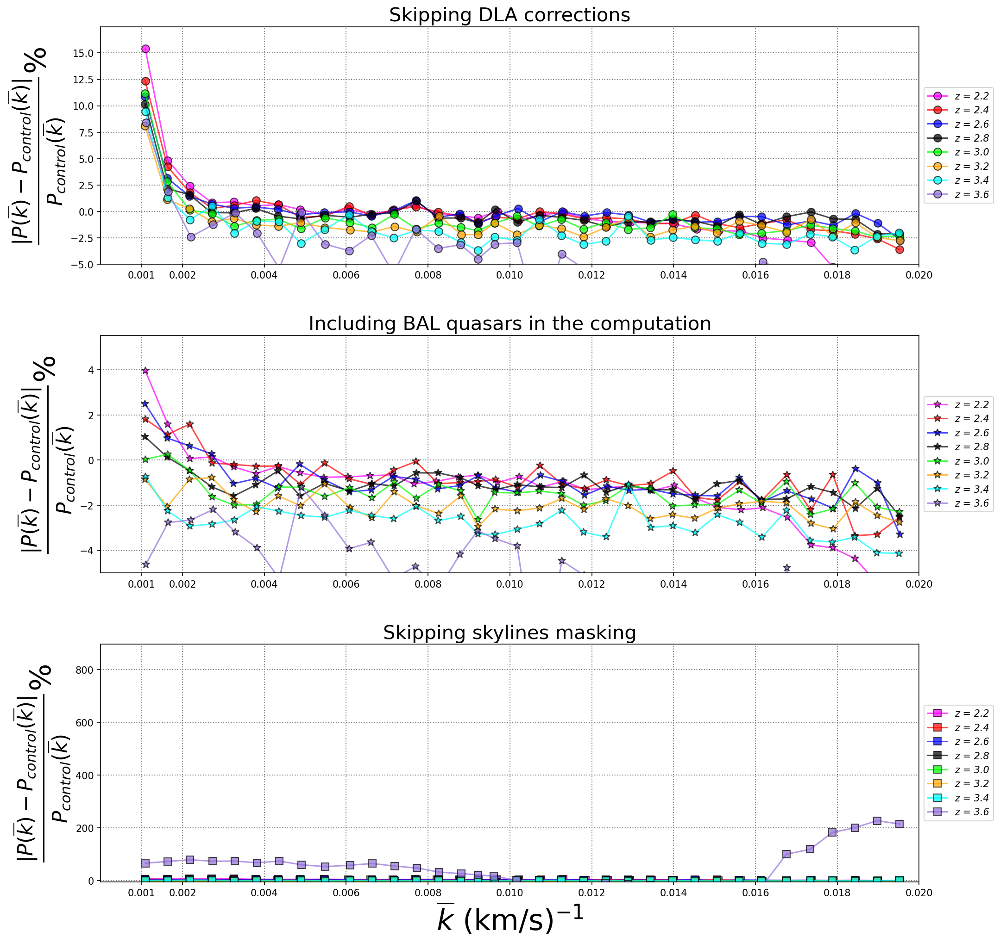

In [322]:
systematicsNA('P1D_eBOSS_DR16_Standard-master.fits.gz',
                  ['P1D_eBOSS_DR16_DLAnot_corrected.fits.gz','P1D_eBOSS_DR16_BALincluded.fits.gz',
                   'P1D_eBOSS_DR16_SkyLines_included.fits.gz'],
                  0,8,3,1,15.2,16,'eBOSS DR16',4,'Sistems DR16.png')